<h3 style="text-align: center;"><b>Школа глубокого обучения ФПМИ МФТИ</b></h3>

<h3 style="text-align: center;"><b>Домашнее задание. Generative adversarial networks</b></h3>



В этом домашнем задании вы обучите GAN генерировать лица людей и посмотрите на то, как можно оценивать качество генерации

In [759]:
import time
import gc
import os


from torch.utils.data import DataLoader, Dataset, ConcatDataset
from torchvision.datasets import ImageFolder
import torchvision.transforms as tt
import torch
import torch.nn as nn
import cv2
from tqdm.notebook import tqdm
from torchvision.utils import save_image
from torchvision.utils import make_grid
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

sns.set(style='darkgrid', font_scale=1.2)

## Часть 1. Подготовка данных (1 балл)

В качестве обучающей выборки возьмем часть датасета [Flickr Faces](https://github.com/NVlabs/ffhq-dataset), который содержит изображения лиц людей в высоком разрешении (1024х1024). Оригинальный датасет очень большой, поэтому мы возьмем его часть. Скачать датасет можно [здесь](https://drive.google.com/file/d/1KWPc4Pa7u2TWekUvNu9rTSO0U2eOlZA9/view?usp=sharing)

Давайте загрузим наши изображения. Напишите функцию, которая строит DataLoader для изображений, при этом меняя их размер до нужного значения (размер 1024 слишком большой, поэтому мы рекомендуем взять размер 128 либо немного больше)

In [625]:
PATH_DATASET = "./datasets/"

In [647]:
# Настройки датасета
image_size=64
stats = [[0.5, 0.5, 0.5], [0.5, 0.5, 0.5]]

In [648]:
device = torch.device('cuda') if torch.cuda.is_available() else torch.device('cpu')
device

device(type='cuda')

In [650]:
def get_dataloader(dataset_path, image_size=128, batch_size=16):
    """
    Builds dataloader for training data.
    Use tt.Compose and tt.Resize for transformations
    :param image_size: height and wdith of the image
    :param batch_size: batch_size of the dataloader
    :returns: DataLoader object 
    """
    transform = tt.Compose([
    tt.Resize(image_size),
    tt.CenterCrop(image_size),
    tt.ToTensor(),
    tt.Normalize(*stats),
    ])
    images_ds = ImageFolder(dataset_path, transform)
    images_loader = DataLoader(images_ds, batch_size, shuffle=True, pin_memory=True)
    return images_ds, images_loader

# Денормализация изображений. Используется для отображения нормализованных картинок
def denormalize(img_tensors):
    return img_tensors * stats[1][0] + stats[0][0]


batch_size = 4

train_images_ds, train_images_loader = get_dataloader(PATH_DATASET, image_size=image_size, batch_size=batch_size)
train_images_ds, train_images_loader

(Dataset ImageFolder
     Number of datapoints: 3143
     Root location: ./datasets/
     StandardTransform
 Transform: Compose(
                Resize(size=64, interpolation=bilinear, max_size=None, antialias=None)
                CenterCrop(size=(64, 64))
                ToTensor()
                Normalize(mean=[0.5, 0.5, 0.5], std=[0.5, 0.5, 0.5])
            ),
 <torch.utils.data.dataloader.DataLoader at 0x20d02a10fc8>)

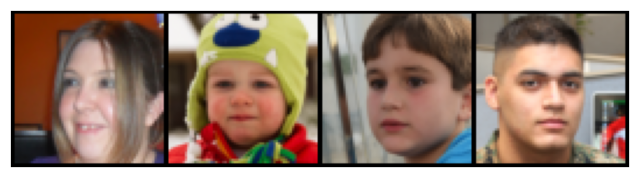

In [651]:
# Отобразить несколько картинок обучающей выборки (первый батч)
first_batch_images, _ = next(iter(train_images_loader))
fig, ax = plt.subplots(figsize=(8, 8))
ax.set_xticks([]); ax.set_yticks([])
ax.imshow(make_grid(denormalize(first_batch_images[0:10]), nrow=5).permute(1, 2, 0))
plt.show()

## Часть 2. Построение и обучение модели (2 балла)

Сконструируйте генератор и дискриминатор. Помните, что:
* дискриминатор принимает на вход изображение (тензор размера `3 x image_size x image_size`) и выдает вероятность того, что изображение настоящее (тензор размера 1)

* генератор принимает на вход тензор шумов размера `latent_size x 1 x 1` и генерирует изображение размера `3 x image_size x image_size`

Перейдем теперь к обучению нашего GANа. Алгоритм обучения следующий:
1. Учим дискриминатор:
  * берем реальные изображения и присваиваем им метку 1
  * генерируем изображения генератором и присваиваем им метку 0
  * обучаем классификатор на два класса

2. Учим генератор:
  * генерируем изображения генератором и присваиваем им метку 0
  * предсказываем дискриминаторором, реальное это изображение или нет


В качестве функции потерь берем бинарную кросс-энтропию

In [688]:
latent_size = 512

In [689]:
class Disscriminator(nn.Module):
    def __init__(self, count_chanels=64):
        super().__init__()
        self.count_chanels = count_chanels
 
        
        self.all = nn.Sequential(
            nn.Conv2d(in_channels=3, out_channels=self.count_chanels, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(self.count_chanels),
            nn.LeakyReLU(),
            nn.Conv2d(in_channels=self.count_chanels, out_channels=self.count_chanels*2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(self.count_chanels*2),
            nn.LeakyReLU(),            
            nn.Conv2d(in_channels=self.count_chanels*2, out_channels=self.count_chanels*4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(self.count_chanels*4),
            nn.LeakyReLU(),            
            nn.Conv2d(in_channels=self.count_chanels*4, out_channels=self.count_chanels*8, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(self.count_chanels*8),
            nn.LeakyReLU(),            
            nn.Conv2d(in_channels=self.count_chanels*8, out_channels=1, kernel_size=5, stride=1, padding=0, bias=False),
#             nn.BatchNorm2d(self.count_chanels*16),
#             nn.ReLU(),            
            
#             nn.Conv2d(in_channels=4, out_channels=1, kernel_size=4, stride=1, padding=0, bias=False),
            nn.Flatten(),
#             nn.Linear(in_features=8*8, out_features=1),
            nn.Sigmoid(), 
            
        )
        
        
    def forward(self, x):
        # print(f"x: {x.shape}")        
        res = self.all(x)
        # print(f"res: {res.shape}")
        return res
        
        

In [690]:
class Generator(nn.Module):
    def __init__(self, latent_size=128, count_chanels=64):
        super().__init__()
        self.count_chanels = count_chanels
        self.latent_size = latent_size
        
        self.all = nn.Sequential(
            nn.ConvTranspose2d(in_channels=latent_size, out_channels=count_chanels*8, kernel_size=4, stride=1, padding=0, bias=False),
            nn.BatchNorm2d(count_chanels*8),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(in_channels=count_chanels*8, out_channels=count_chanels*4, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(count_chanels*4),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(in_channels=count_chanels*4, out_channels=count_chanels*2, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(count_chanels*2),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(in_channels=count_chanels*2, out_channels=count_chanels, kernel_size=4, stride=2, padding=1, bias=False),
            nn.BatchNorm2d(count_chanels),
            nn.ReLU(True),
            
            nn.ConvTranspose2d(in_channels=count_chanels, out_channels=3, kernel_size=4, stride=2, padding=1, bias=False),
            nn.Tanh()
        )

    
    def forward(self, x):
        res = self.all(x)
        return res
        
        

In [692]:

lr = 0.0001

model = {
    "discriminator": Disscriminator().to(device),
    "generator": Generator(latent_size).to(device),
}

optimizer = {
    "discriminator": torch.optim.Adam(model["discriminator"].parameters(), lr=lr),
    "generator": torch.optim.Adam(model["generator"].parameters(), lr=lr)
}

criterion = {
    "discriminator": nn.BCELoss(),
    "generator": nn.BCELoss()
}

  0%|          | 0/60 [00:00<?, ?it/s]

epoch: 0


  0%|          | 0/786 [00:00<?, ?it/s]

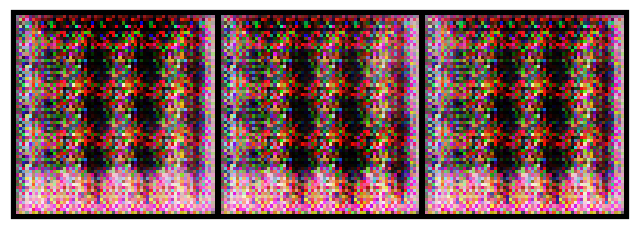

epoch: 1


  0%|          | 0/786 [00:00<?, ?it/s]

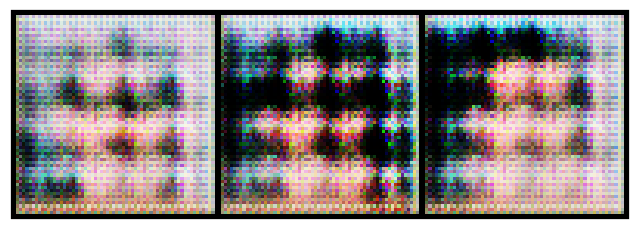

epoch: 2


  0%|          | 0/786 [00:00<?, ?it/s]

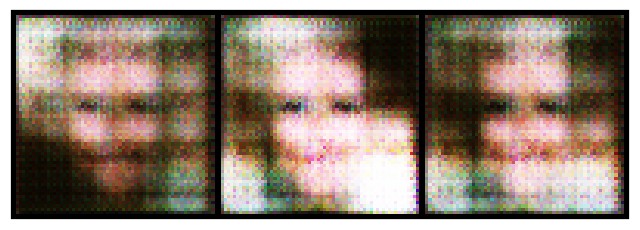

epoch: 3


  0%|          | 0/786 [00:00<?, ?it/s]

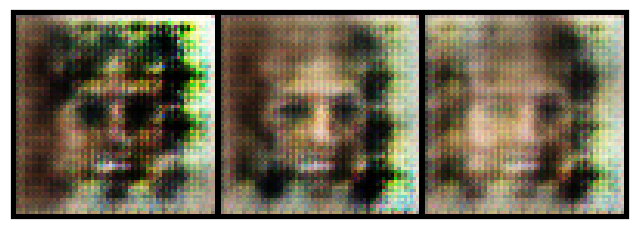

epoch: 4


  0%|          | 0/786 [00:00<?, ?it/s]

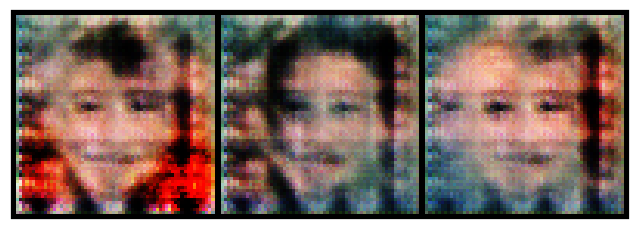

epoch: 5


  0%|          | 0/786 [00:00<?, ?it/s]

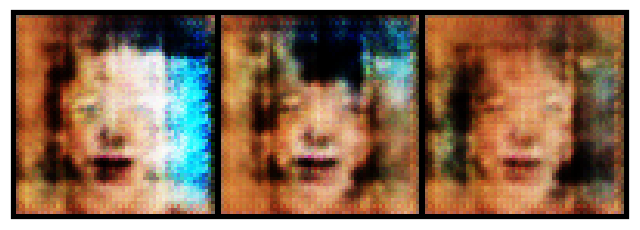

epoch: 6


  0%|          | 0/786 [00:00<?, ?it/s]

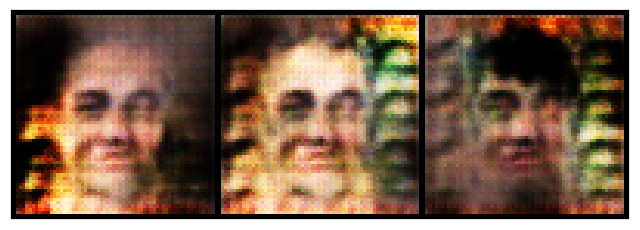

epoch: 7


  0%|          | 0/786 [00:00<?, ?it/s]

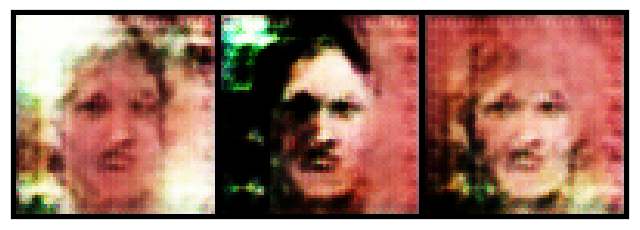

epoch: 8


  0%|          | 0/786 [00:00<?, ?it/s]

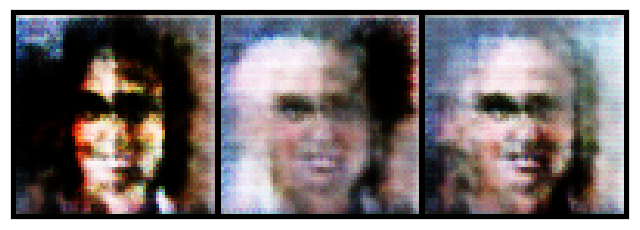

epoch: 9


  0%|          | 0/786 [00:00<?, ?it/s]

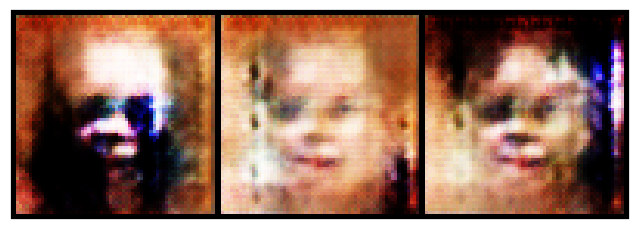

epoch: 10


  0%|          | 0/786 [00:00<?, ?it/s]

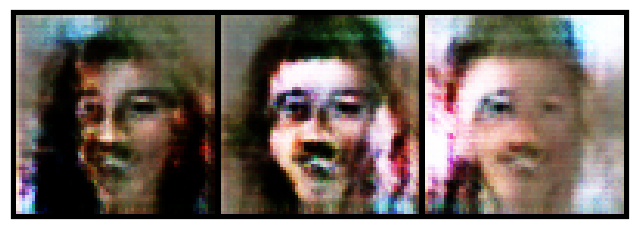

epoch: 11


  0%|          | 0/786 [00:00<?, ?it/s]

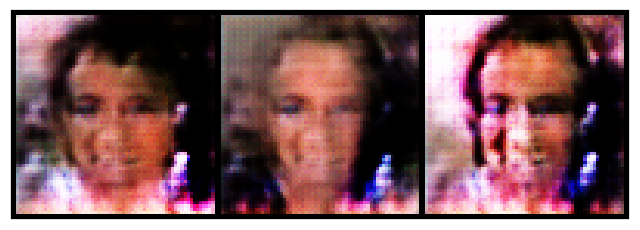

epoch: 12


  0%|          | 0/786 [00:00<?, ?it/s]

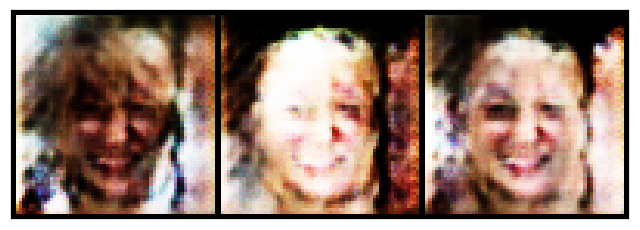

epoch: 13


  0%|          | 0/786 [00:00<?, ?it/s]

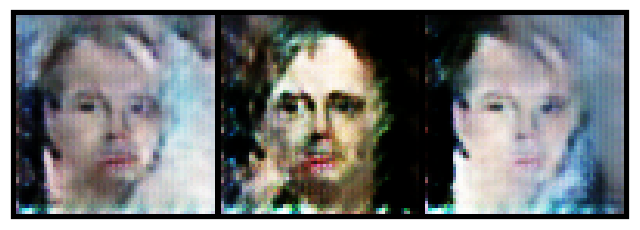

epoch: 14


  0%|          | 0/786 [00:00<?, ?it/s]

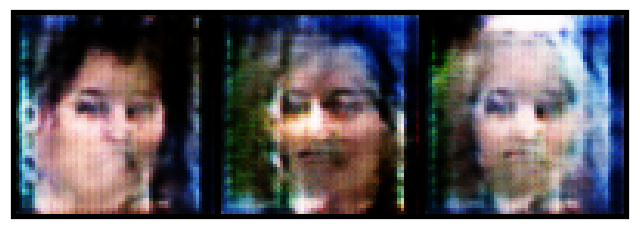

epoch: 15


  0%|          | 0/786 [00:00<?, ?it/s]

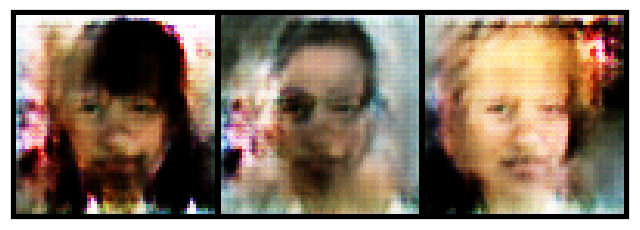

epoch: 16


  0%|          | 0/786 [00:00<?, ?it/s]

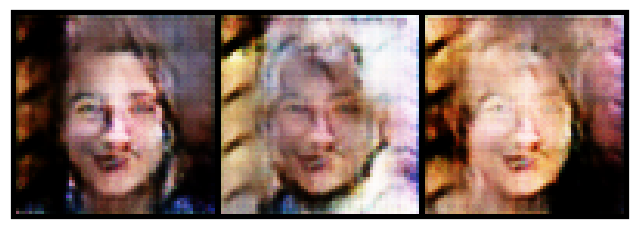

epoch: 17


  0%|          | 0/786 [00:00<?, ?it/s]

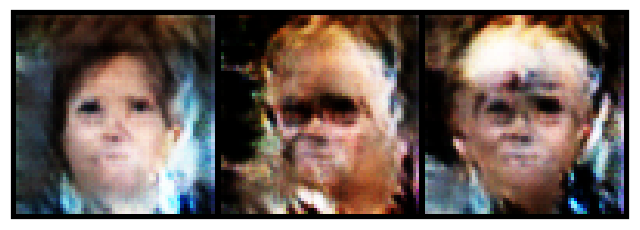

epoch: 18


  0%|          | 0/786 [00:00<?, ?it/s]

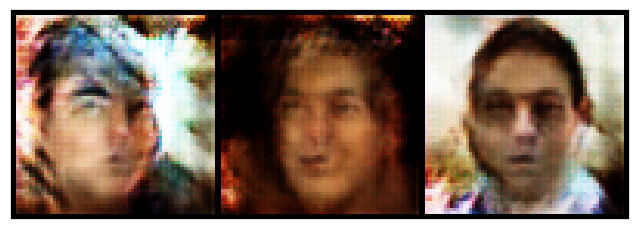

epoch: 19


  0%|          | 0/786 [00:00<?, ?it/s]

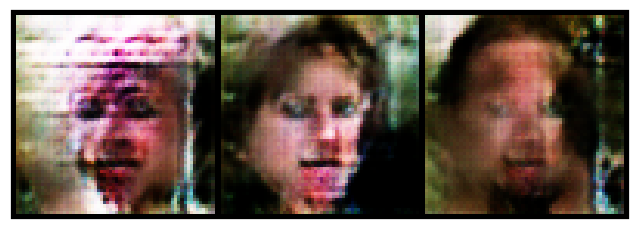

epoch: 20


  0%|          | 0/786 [00:00<?, ?it/s]

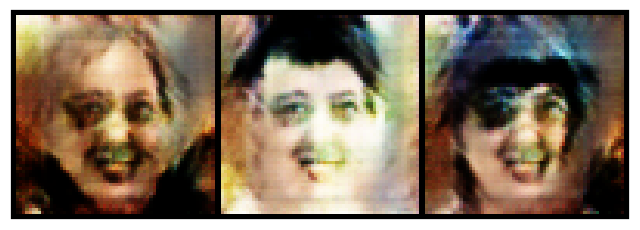

epoch: 21


  0%|          | 0/786 [00:00<?, ?it/s]

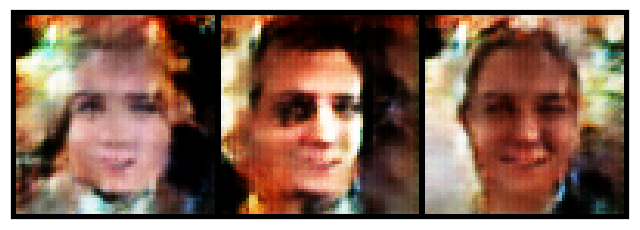

epoch: 22


  0%|          | 0/786 [00:00<?, ?it/s]

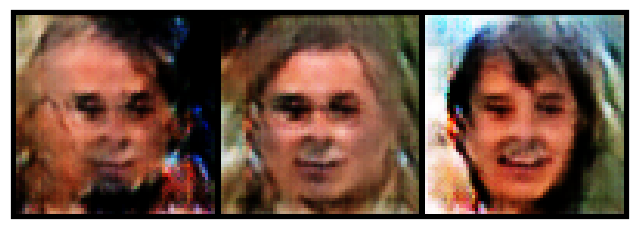

epoch: 23


  0%|          | 0/786 [00:00<?, ?it/s]

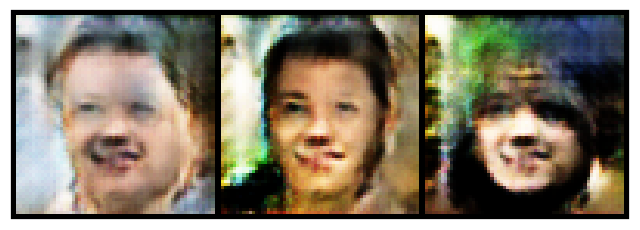

epoch: 24


  0%|          | 0/786 [00:00<?, ?it/s]

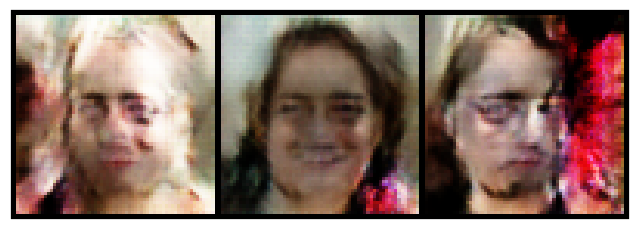

epoch: 25


  0%|          | 0/786 [00:00<?, ?it/s]

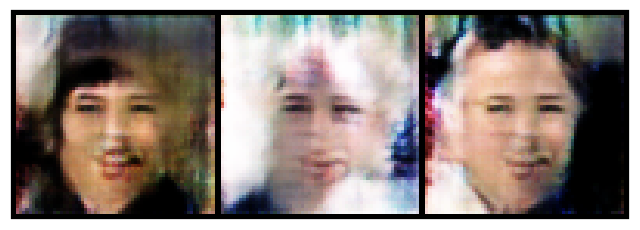

epoch: 26


  0%|          | 0/786 [00:00<?, ?it/s]

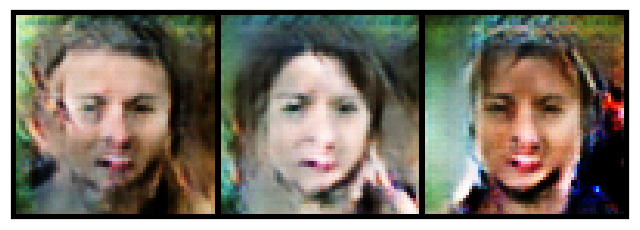

epoch: 27


  0%|          | 0/786 [00:00<?, ?it/s]

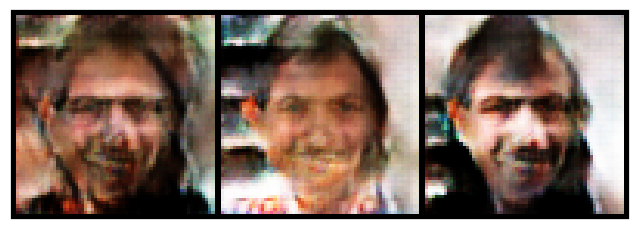

epoch: 28


  0%|          | 0/786 [00:00<?, ?it/s]

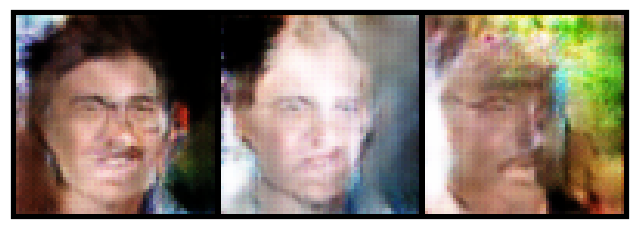

epoch: 29


  0%|          | 0/786 [00:00<?, ?it/s]

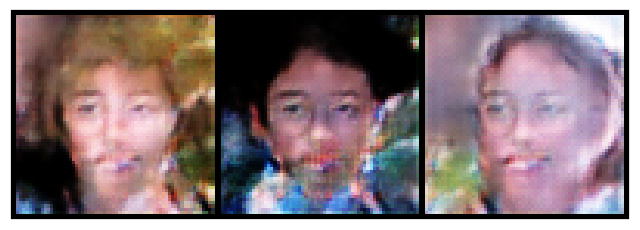

epoch: 30


  0%|          | 0/786 [00:00<?, ?it/s]

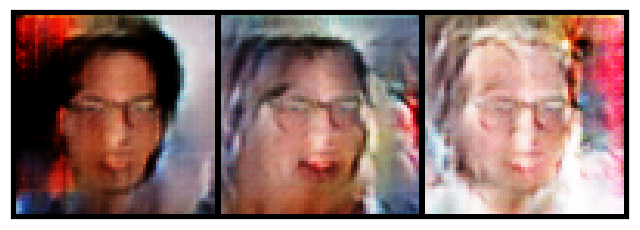

epoch: 31


  0%|          | 0/786 [00:00<?, ?it/s]

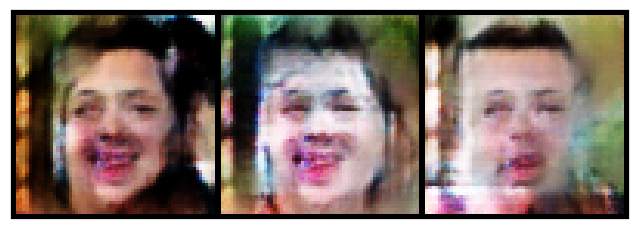

epoch: 32


  0%|          | 0/786 [00:00<?, ?it/s]

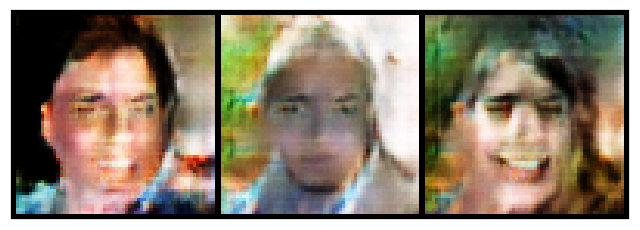

epoch: 33


  0%|          | 0/786 [00:00<?, ?it/s]

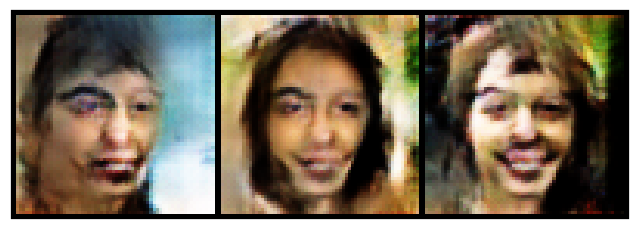

epoch: 34


  0%|          | 0/786 [00:00<?, ?it/s]

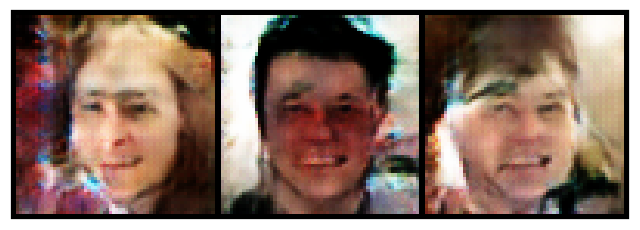

epoch: 35


  0%|          | 0/786 [00:00<?, ?it/s]

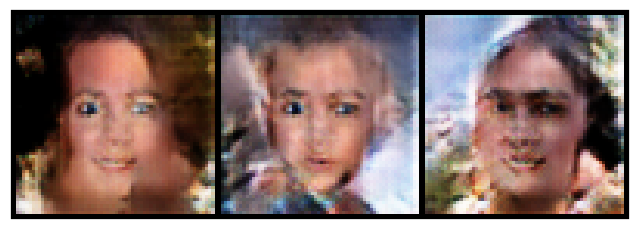

epoch: 36


  0%|          | 0/786 [00:00<?, ?it/s]

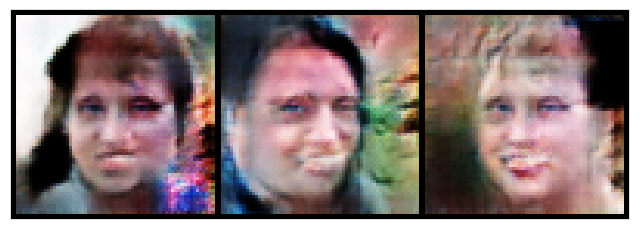

epoch: 37


  0%|          | 0/786 [00:00<?, ?it/s]

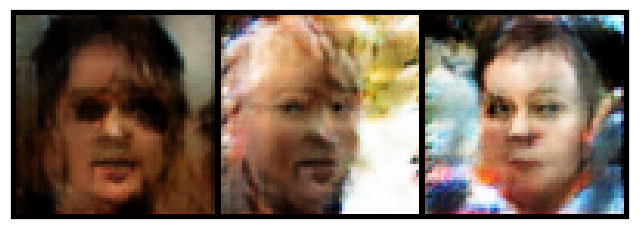

epoch: 38


  0%|          | 0/786 [00:00<?, ?it/s]

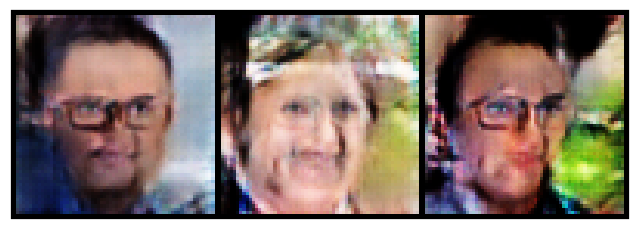

epoch: 39


  0%|          | 0/786 [00:00<?, ?it/s]

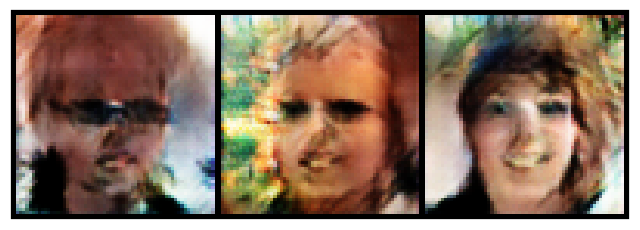

epoch: 40


  0%|          | 0/786 [00:00<?, ?it/s]

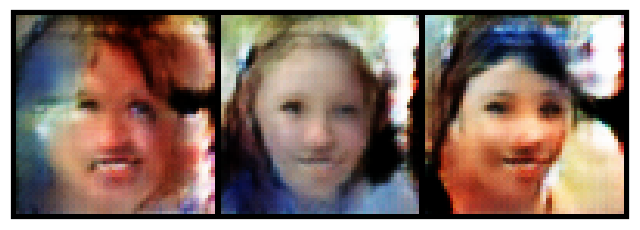

epoch: 41


  0%|          | 0/786 [00:00<?, ?it/s]

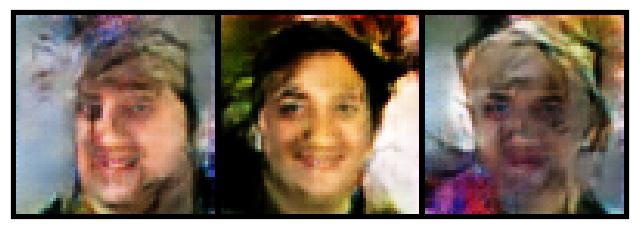

epoch: 42


  0%|          | 0/786 [00:00<?, ?it/s]

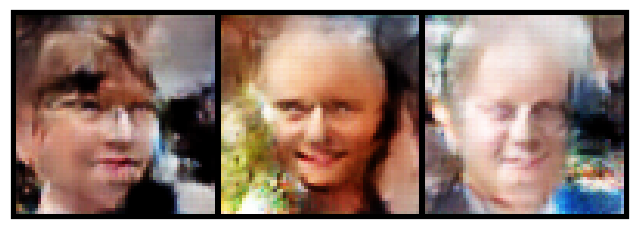

epoch: 43


  0%|          | 0/786 [00:00<?, ?it/s]

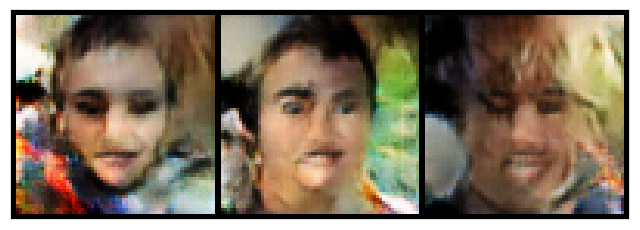

epoch: 44


  0%|          | 0/786 [00:00<?, ?it/s]

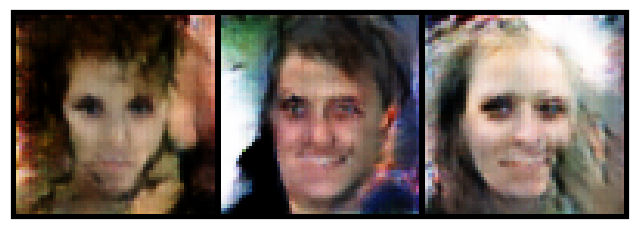

epoch: 45


  0%|          | 0/786 [00:00<?, ?it/s]

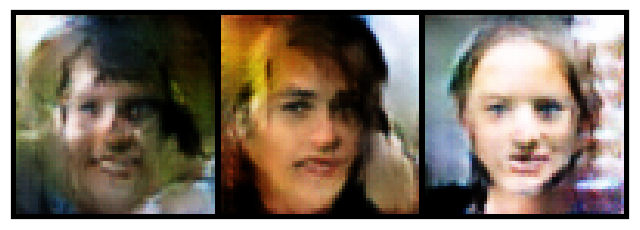

epoch: 46


  0%|          | 0/786 [00:00<?, ?it/s]

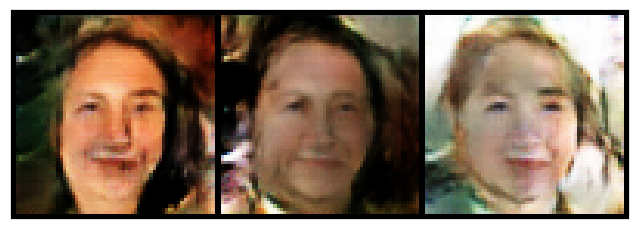

epoch: 47


  0%|          | 0/786 [00:00<?, ?it/s]

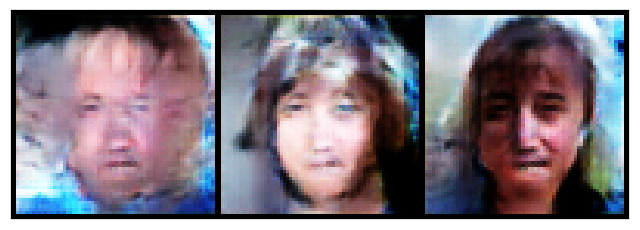

epoch: 48


  0%|          | 0/786 [00:00<?, ?it/s]

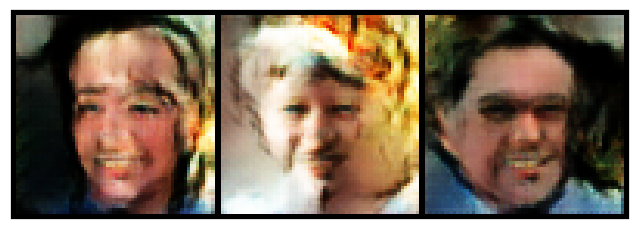

epoch: 49


  0%|          | 0/786 [00:00<?, ?it/s]

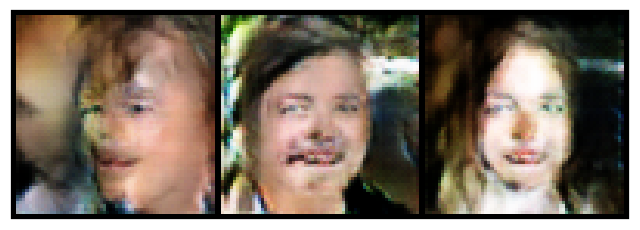

epoch: 50


  0%|          | 0/786 [00:00<?, ?it/s]

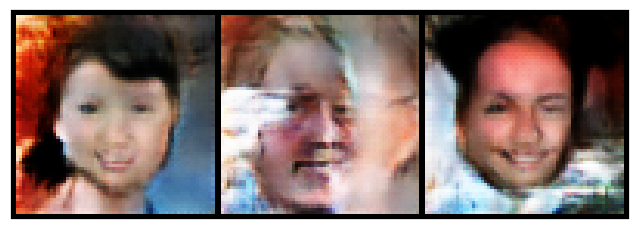

epoch: 51


  0%|          | 0/786 [00:00<?, ?it/s]

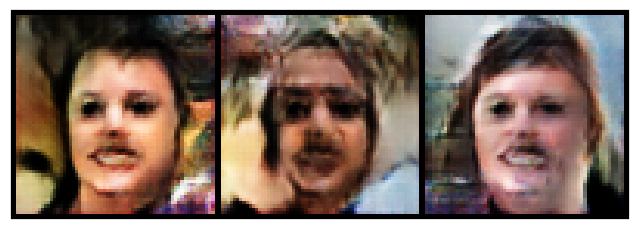

epoch: 52


  0%|          | 0/786 [00:00<?, ?it/s]

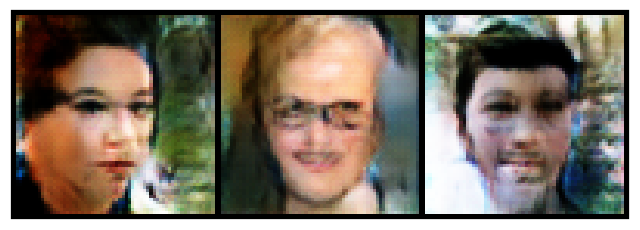

epoch: 53


  0%|          | 0/786 [00:00<?, ?it/s]

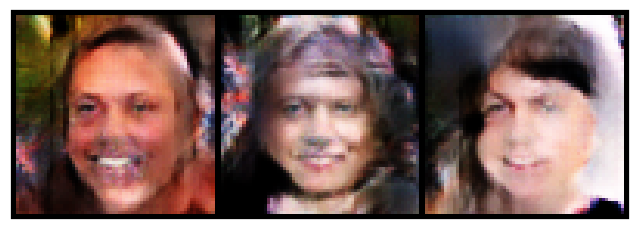

epoch: 54


  0%|          | 0/786 [00:00<?, ?it/s]

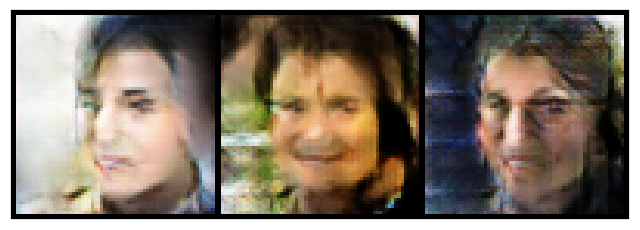

epoch: 55


  0%|          | 0/786 [00:00<?, ?it/s]

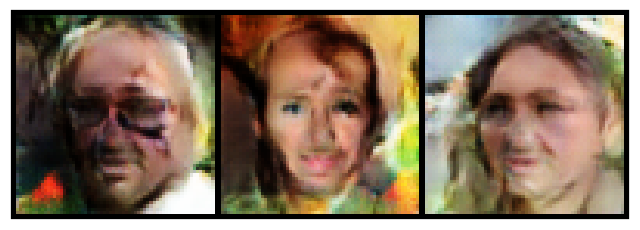

epoch: 56


  0%|          | 0/786 [00:00<?, ?it/s]

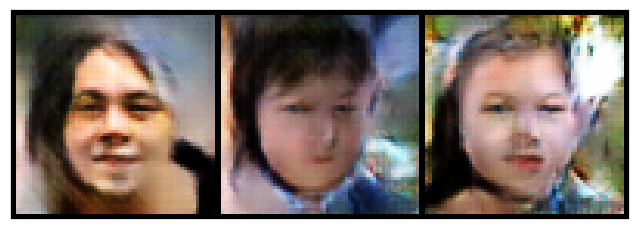

epoch: 57


  0%|          | 0/786 [00:00<?, ?it/s]

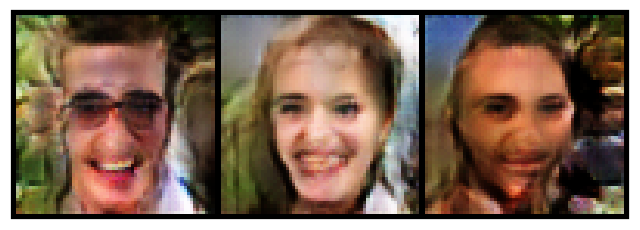

epoch: 58


  0%|          | 0/786 [00:00<?, ?it/s]

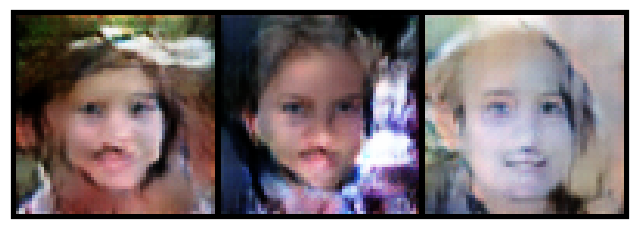

epoch: 59


  0%|          | 0/786 [00:00<?, ?it/s]

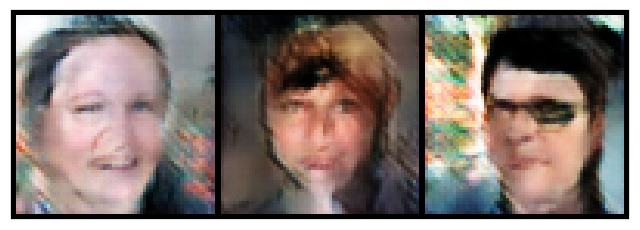

In [695]:

def fit(model, criterion, optimizer, epochs, train_images_loader):
    torch.cuda.empty_cache()
    gc.collect()    
    model["discriminator"].train()
    model["generator"].train()    
    history = []
    i = 0
    for epoch in tqdm(range(epochs)):
        print(f"epoch: {epoch}")
        mean_real_discriminator_loss = 0
        mean_fake_discriminator_loss = 0
        mean_discriminator_loss = 0
        mean_generator_loss = 0
        for img_batch, classes in tqdm(train_images_loader):
            img_batch = img_batch.to(device)
#             print(img_batch.shape)
            # Обучаем дискриминатор на хороших и плохих картинках
            # Очищаем градиенты
            optimizer["discriminator"].zero_grad()
            
            # Прогнозируем класс для заведомо хороших картинок (класс 1)
            real_targets = torch.ones(img_batch.shape[0])
            real_pred = model["discriminator"](img_batch)[:, 0].cpu()
            real_discriminator_loss = criterion["discriminator"](real_pred, real_targets)
            
            # Генерируем примеры фейковых картинок (класс 0)
            fake_targets = torch.zeros(img_batch.shape[0])
            fake_latent = torch.randn(img_batch.shape[0], latent_size)
            #print(f"fake_latent.shape: {fake_latent.shape}")
            #print(f"latent.shape: {latent.shape}")
            fake_gen_image = model["generator"](fake_latent.to(device)[:,:,None,None])
            #print(f"fake_gen_image.shape: {fake_gen_image.shape}")
            
            
            # Прогнозируем класс для заведомо плохих картинок
            fake_pred = model["discriminator"](fake_gen_image)[:, 0].cpu()
            fake_discriminator_loss = criterion["discriminator"](fake_pred, fake_targets)
            # Общий лосс дискриминатора
            discriminator_loss = real_discriminator_loss + fake_discriminator_loss
            mean_real_discriminator_loss += real_discriminator_loss
            mean_fake_discriminator_loss += fake_discriminator_loss
            mean_discriminator_loss += discriminator_loss
        
            # Делаем бэкпропагейшн и шаг оптимизатора 
            discriminator_loss.backward()
            optimizer["discriminator"].step()
            
            # Обучаем Генератор
            # Очищаем градиенты
            optimizer["generator"].zero_grad()
            
            # Генерируем изображение из случайной выборке 
            latent = torch.randn(img_batch.shape[0], latent_size)
            gen_image = model["generator"](latent.to(device)[:,:,None,None])
            
            # Смотрим как дискриминатор определит сгененрированную картинку
            # Но теперь мы говорим дискриминатору что это нужные нам картинки (класс 1)
            gen_targets = torch.ones(img_batch.shape[0])
            gen_pred = model["discriminator"](gen_image)[:, 0].cpu()
            generator_loss = criterion["generator"](gen_pred, gen_targets)
            mean_generator_loss += generator_loss
#             print(f"generator_loss: {generator_loss}")
            
                        
            generator_loss.backward()
            optimizer["generator"].step()
            
        fig, ax = plt.subplots(figsize=(8, 8))
        ax.set_xticks([]); ax.set_yticks([])
        ax.imshow(make_grid(denormalize(gen_image.cpu().detach()), nrow=8).permute(1, 2, 0))
        plt.show()
        
        mean_real_discriminator_loss = mean_real_discriminator_loss / len(train_images_loader)
        mean_fake_discriminator_loss = mean_fake_discriminator_loss / len(train_images_loader)
        mean_discriminator_loss = mean_discriminator_loss / len(train_images_loader)
        mean_generator_loss = mean_generator_loss / len(train_images_loader)
        
        history.append((mean_real_discriminator_loss.detach().cpu(), mean_fake_discriminator_loss.detach().cpu(), mean_discriminator_loss.detach().cpu(), mean_generator_loss.detach().cpu()))
    return history

history = fit(model, criterion, optimizer, epochs=60, train_images_loader=train_images_loader)

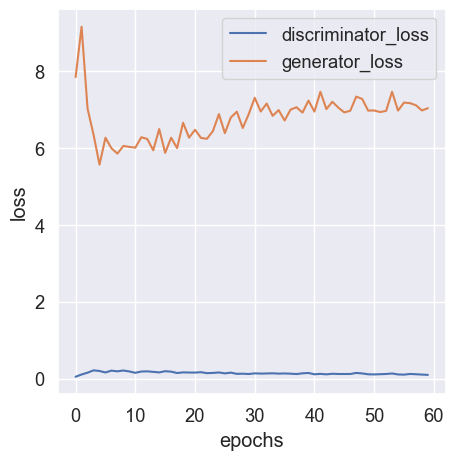

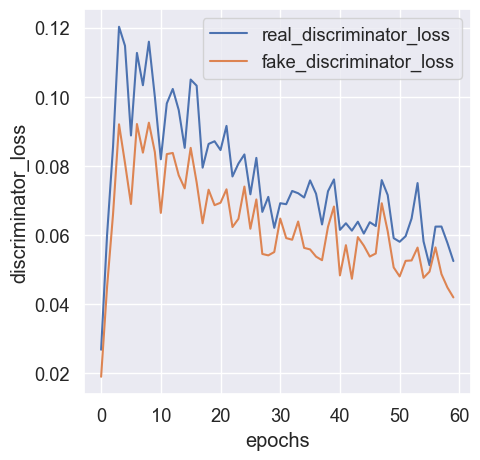

In [696]:
real_discriminator_loss, fake_discriminator_loss, discriminator_loss, generator_loss = zip(*history)

plt.figure(figsize=(5, 5))
plt.plot(discriminator_loss, label="discriminator_loss")
plt.plot(generator_loss, label="generator_loss")
plt.legend(loc='best')
plt.xlabel("epochs")
plt.ylabel("loss")
plt.show()


plt.figure(figsize=(5, 5))
plt.plot(real_discriminator_loss, label="real_discriminator_loss")
plt.plot(fake_discriminator_loss, label="fake_discriminator_loss")
plt.legend(loc='best')
plt.xlabel("epochs")
plt.ylabel("discriminator_loss")
plt.show()

  0%|          | 0/60 [00:00<?, ?it/s]

epoch: 0


  0%|          | 0/786 [00:00<?, ?it/s]

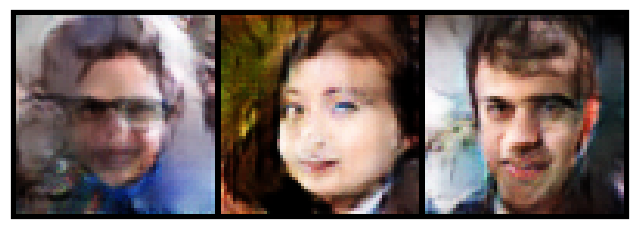

epoch: 1


  0%|          | 0/786 [00:00<?, ?it/s]

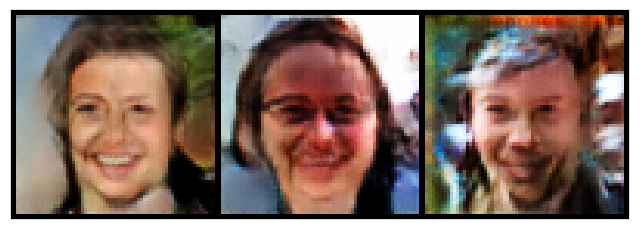

epoch: 2


  0%|          | 0/786 [00:00<?, ?it/s]

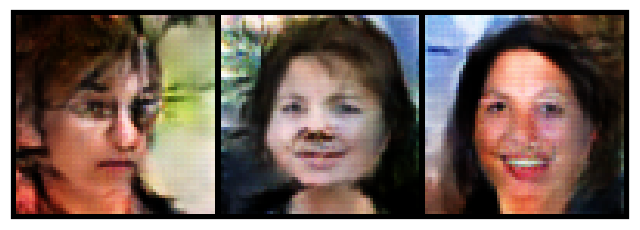

epoch: 3


  0%|          | 0/786 [00:00<?, ?it/s]

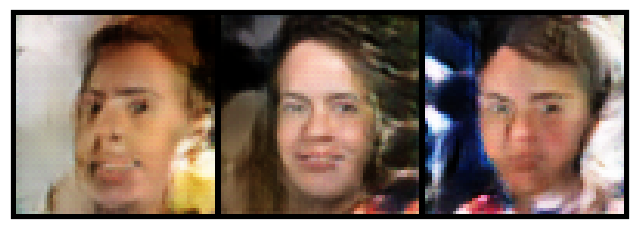

epoch: 4


  0%|          | 0/786 [00:00<?, ?it/s]

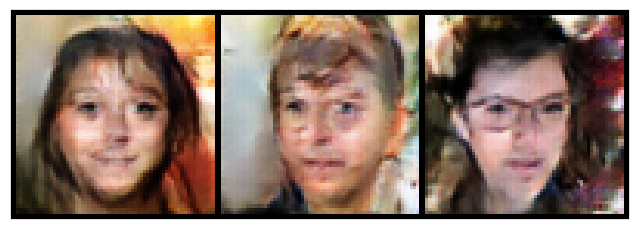

epoch: 5


  0%|          | 0/786 [00:00<?, ?it/s]

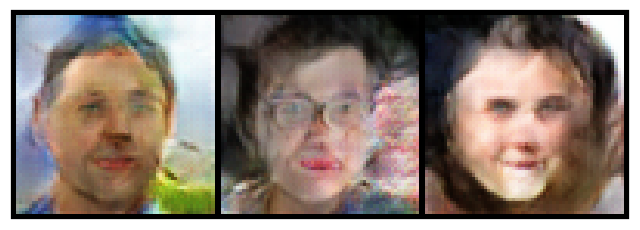

epoch: 6


  0%|          | 0/786 [00:00<?, ?it/s]

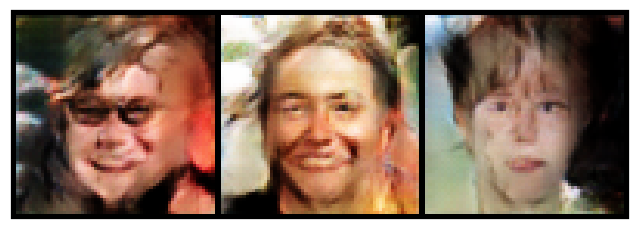

epoch: 7


  0%|          | 0/786 [00:00<?, ?it/s]

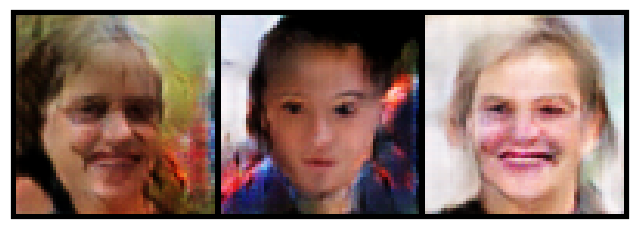

epoch: 8


  0%|          | 0/786 [00:00<?, ?it/s]

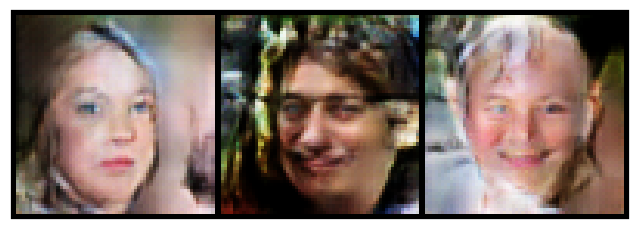

epoch: 9


  0%|          | 0/786 [00:00<?, ?it/s]

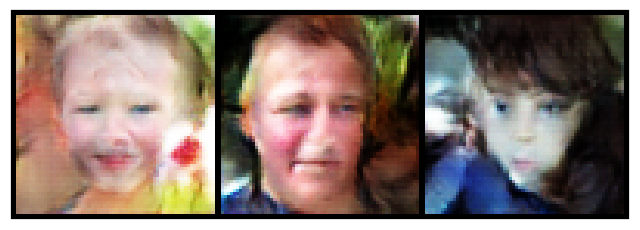

epoch: 10


  0%|          | 0/786 [00:00<?, ?it/s]

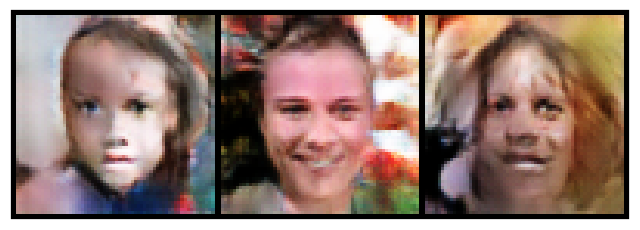

epoch: 11


  0%|          | 0/786 [00:00<?, ?it/s]

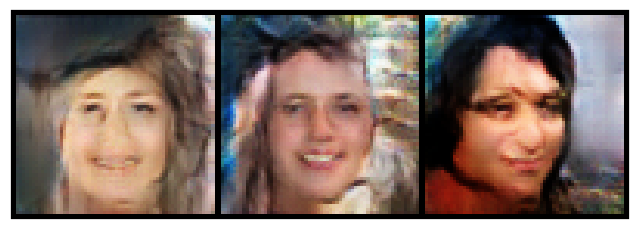

epoch: 12


  0%|          | 0/786 [00:00<?, ?it/s]

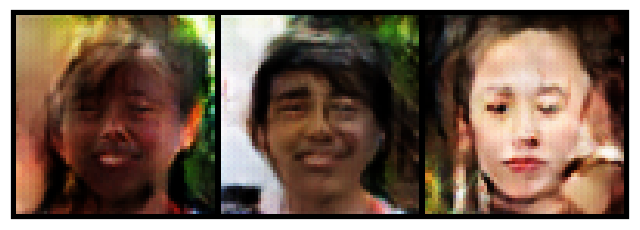

epoch: 13


  0%|          | 0/786 [00:00<?, ?it/s]

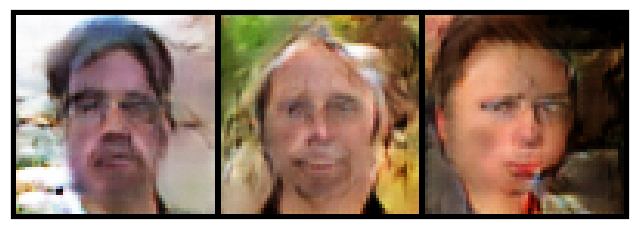

epoch: 14


  0%|          | 0/786 [00:00<?, ?it/s]

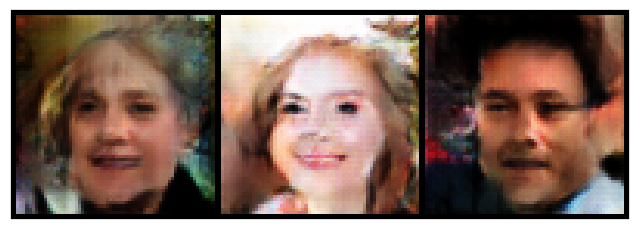

epoch: 15


  0%|          | 0/786 [00:00<?, ?it/s]

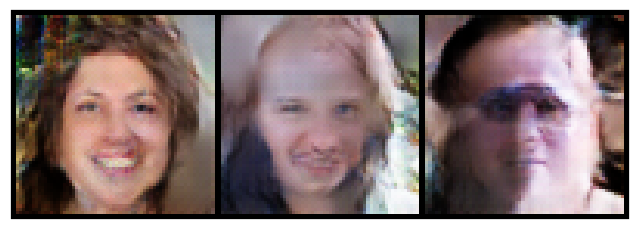

epoch: 16


  0%|          | 0/786 [00:00<?, ?it/s]

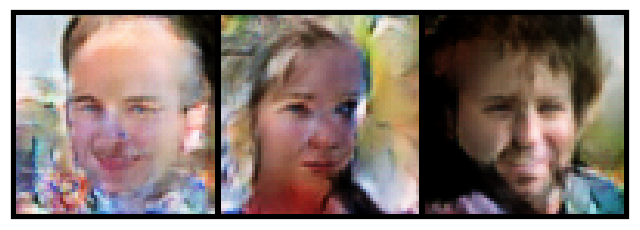

epoch: 17


  0%|          | 0/786 [00:00<?, ?it/s]

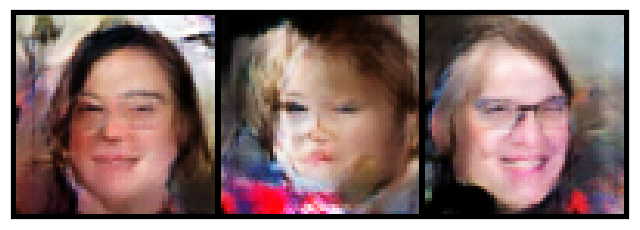

epoch: 18


  0%|          | 0/786 [00:00<?, ?it/s]

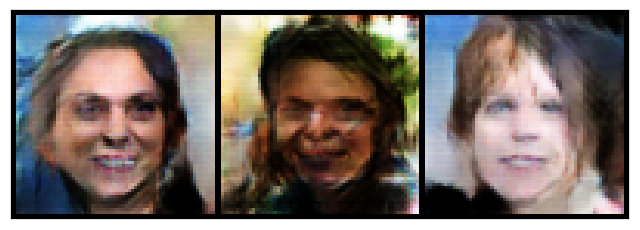

epoch: 19


  0%|          | 0/786 [00:00<?, ?it/s]

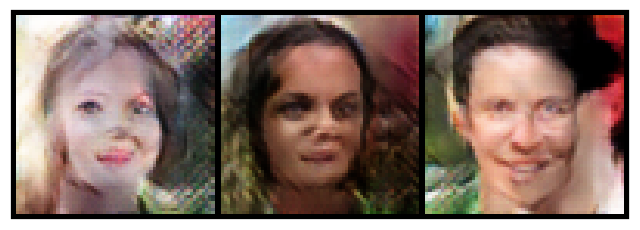

epoch: 20


  0%|          | 0/786 [00:00<?, ?it/s]

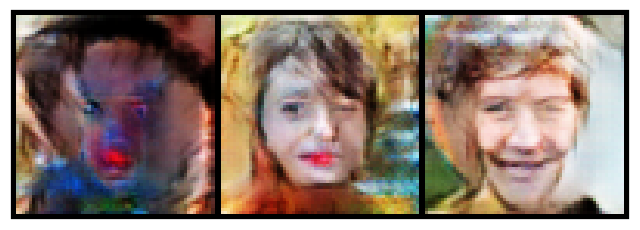

epoch: 21


  0%|          | 0/786 [00:00<?, ?it/s]

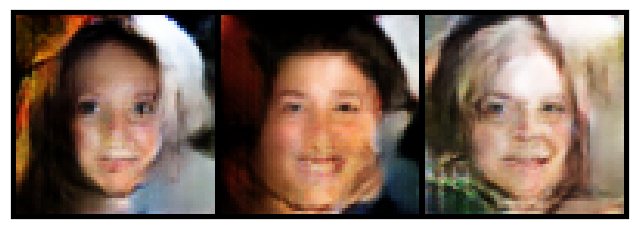

epoch: 22


  0%|          | 0/786 [00:00<?, ?it/s]

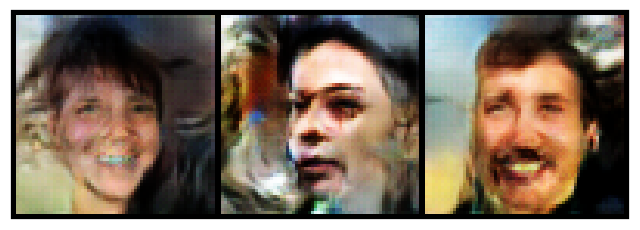

epoch: 23


  0%|          | 0/786 [00:00<?, ?it/s]

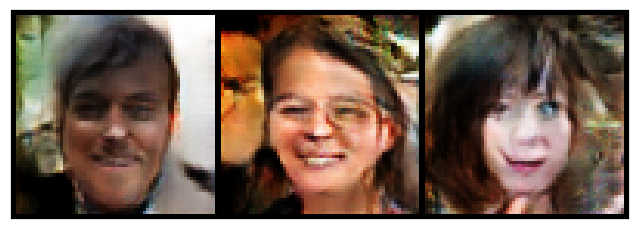

epoch: 24


  0%|          | 0/786 [00:00<?, ?it/s]

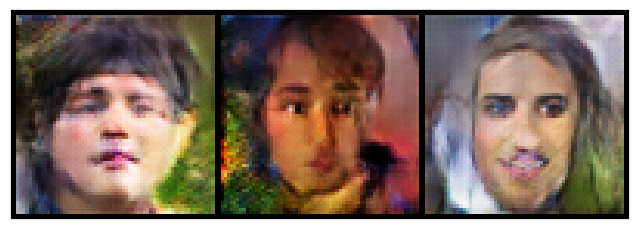

epoch: 25


  0%|          | 0/786 [00:00<?, ?it/s]

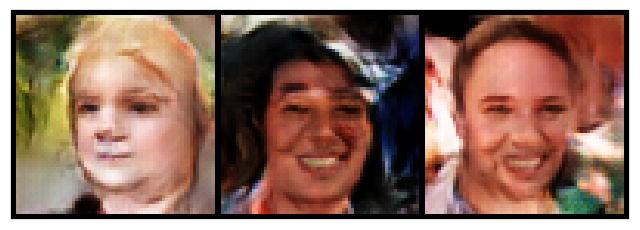

epoch: 26


  0%|          | 0/786 [00:00<?, ?it/s]

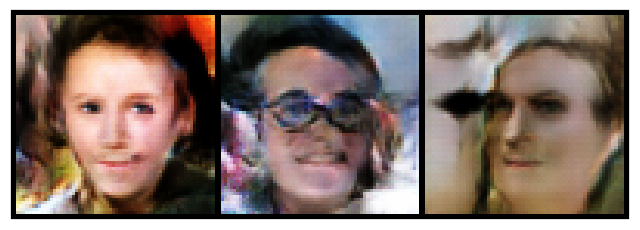

epoch: 27


  0%|          | 0/786 [00:00<?, ?it/s]

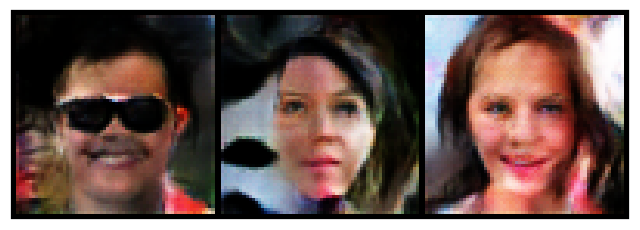

epoch: 28


  0%|          | 0/786 [00:00<?, ?it/s]

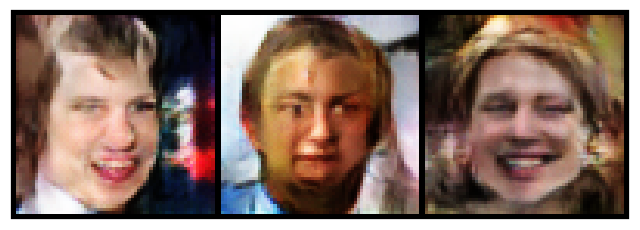

epoch: 29


  0%|          | 0/786 [00:00<?, ?it/s]

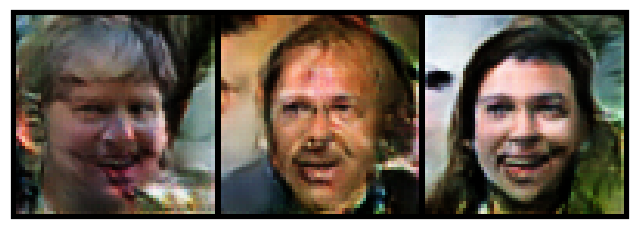

epoch: 30


  0%|          | 0/786 [00:00<?, ?it/s]

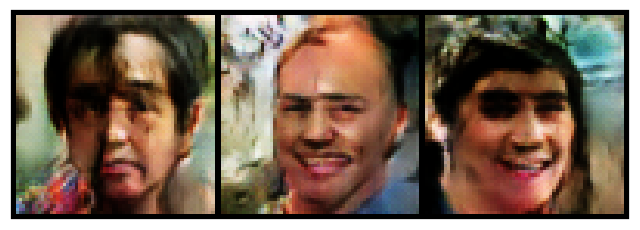

epoch: 31


  0%|          | 0/786 [00:00<?, ?it/s]

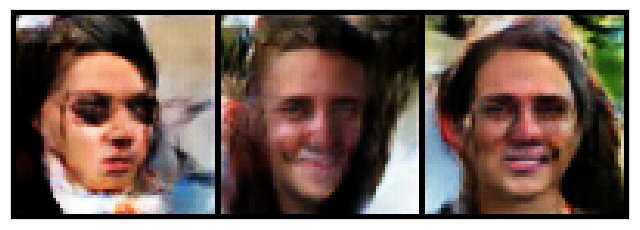

epoch: 32


  0%|          | 0/786 [00:00<?, ?it/s]

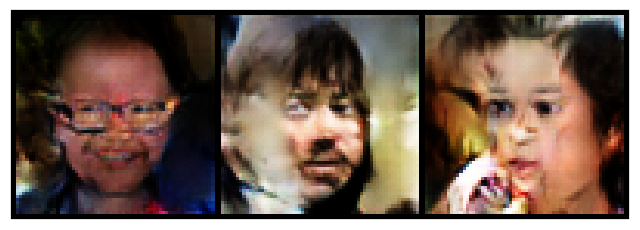

epoch: 33


  0%|          | 0/786 [00:00<?, ?it/s]

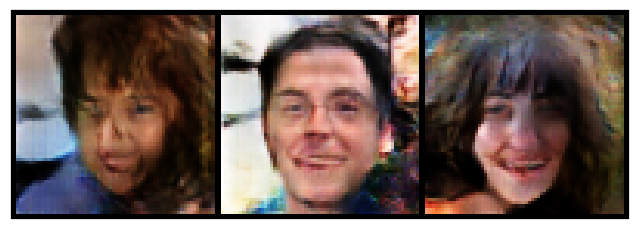

epoch: 34


  0%|          | 0/786 [00:00<?, ?it/s]

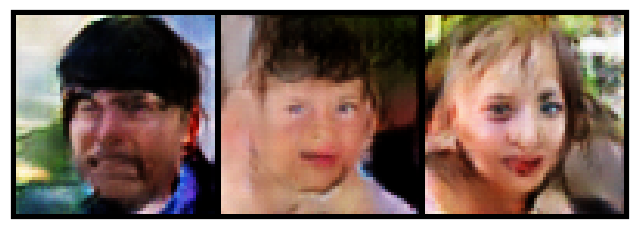

epoch: 35


  0%|          | 0/786 [00:00<?, ?it/s]

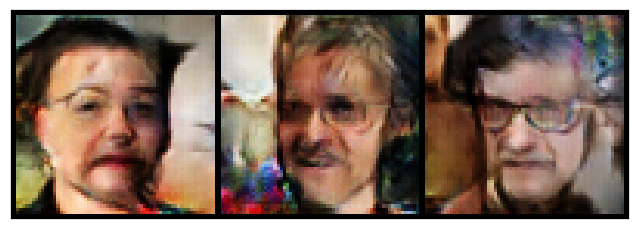

epoch: 36


  0%|          | 0/786 [00:00<?, ?it/s]

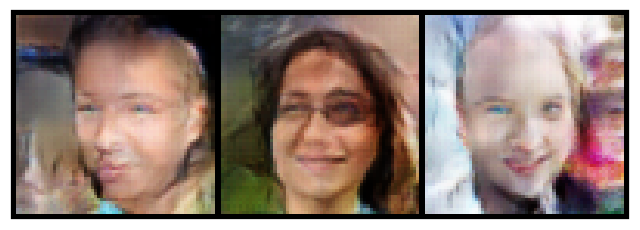

epoch: 37


  0%|          | 0/786 [00:00<?, ?it/s]

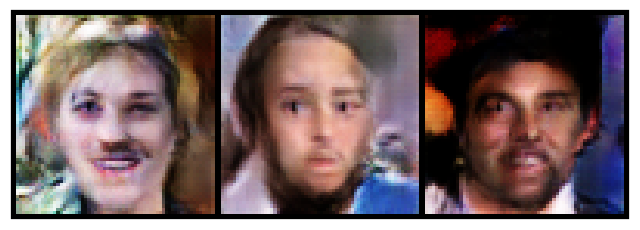

epoch: 38


  0%|          | 0/786 [00:00<?, ?it/s]

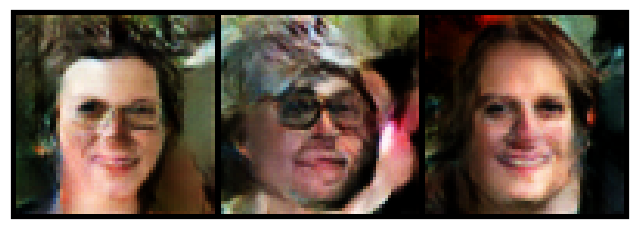

epoch: 39


  0%|          | 0/786 [00:00<?, ?it/s]

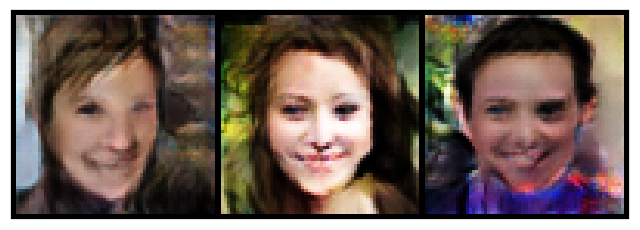

epoch: 40


  0%|          | 0/786 [00:00<?, ?it/s]

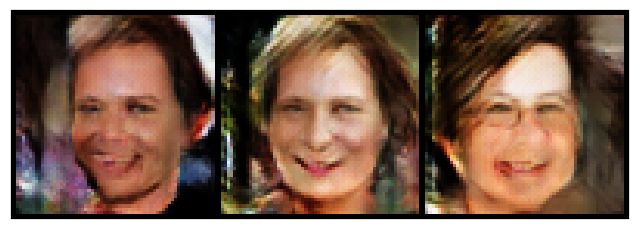

epoch: 41


  0%|          | 0/786 [00:00<?, ?it/s]

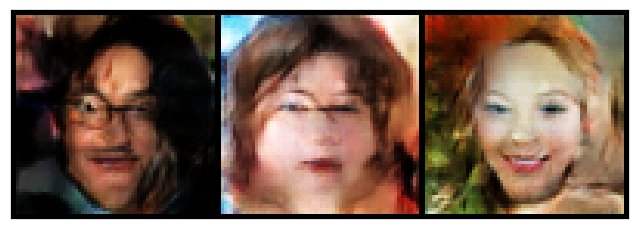

epoch: 42


  0%|          | 0/786 [00:00<?, ?it/s]

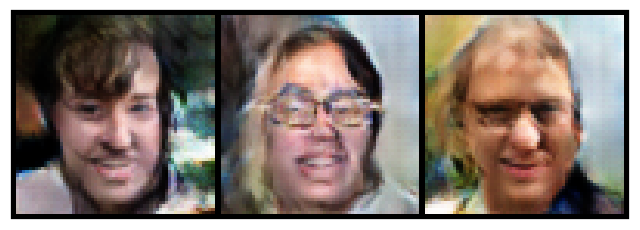

epoch: 43


  0%|          | 0/786 [00:00<?, ?it/s]

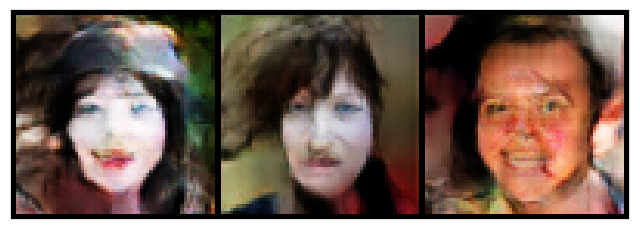

epoch: 44


  0%|          | 0/786 [00:00<?, ?it/s]

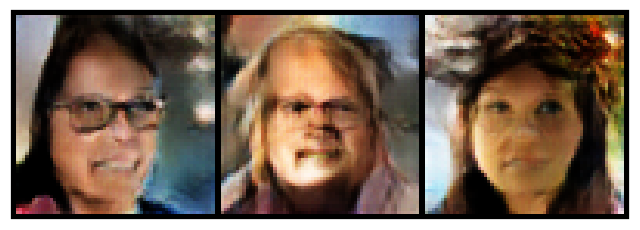

epoch: 45


  0%|          | 0/786 [00:00<?, ?it/s]

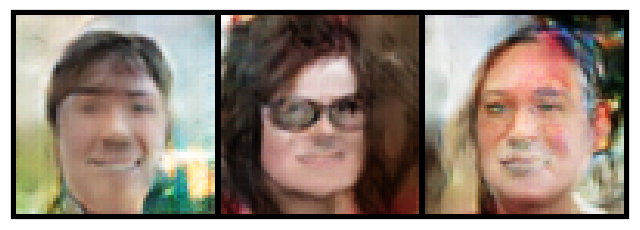

epoch: 46


  0%|          | 0/786 [00:00<?, ?it/s]

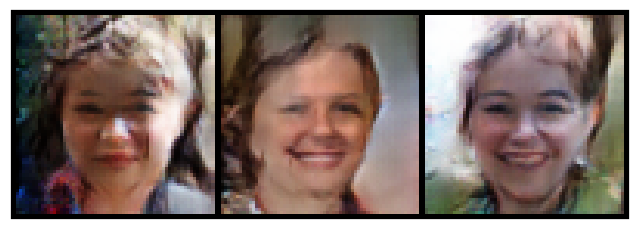

epoch: 47


  0%|          | 0/786 [00:00<?, ?it/s]

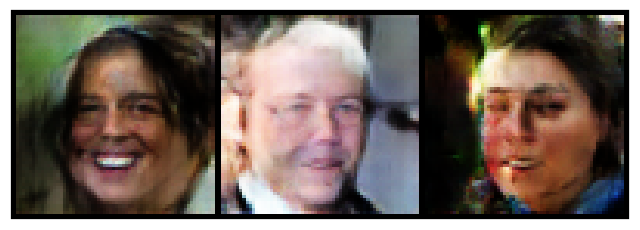

epoch: 48


  0%|          | 0/786 [00:00<?, ?it/s]

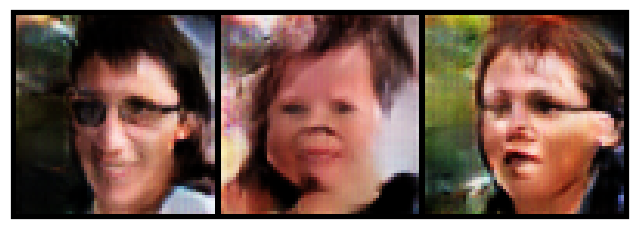

epoch: 49


  0%|          | 0/786 [00:00<?, ?it/s]

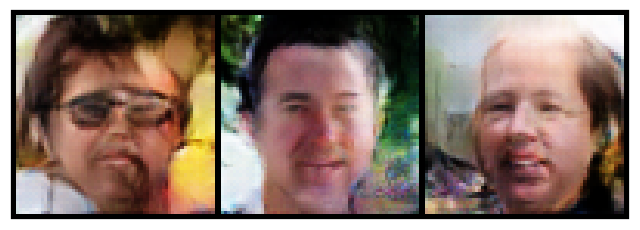

epoch: 50


  0%|          | 0/786 [00:00<?, ?it/s]

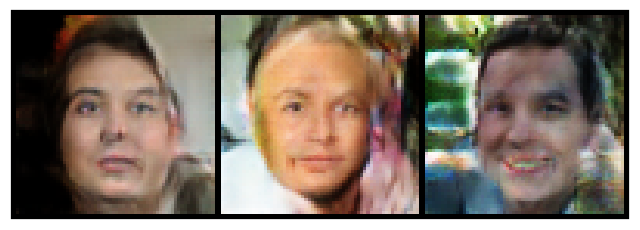

epoch: 51


  0%|          | 0/786 [00:00<?, ?it/s]

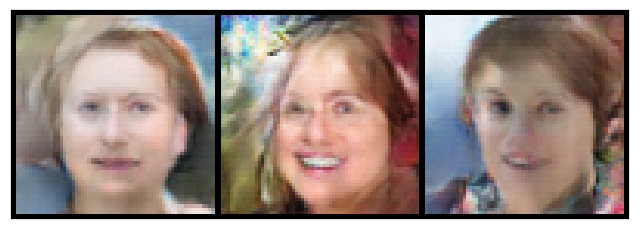

epoch: 52


  0%|          | 0/786 [00:00<?, ?it/s]

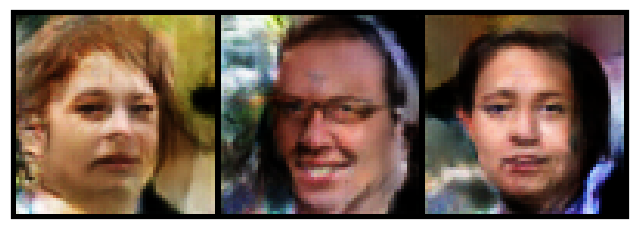

epoch: 53


  0%|          | 0/786 [00:00<?, ?it/s]

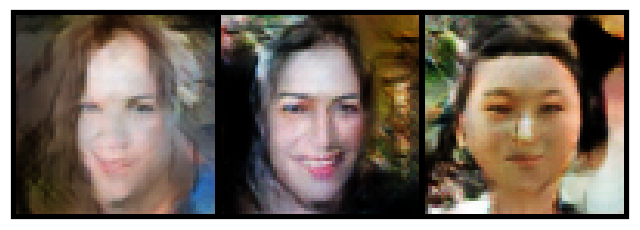

epoch: 54


  0%|          | 0/786 [00:00<?, ?it/s]

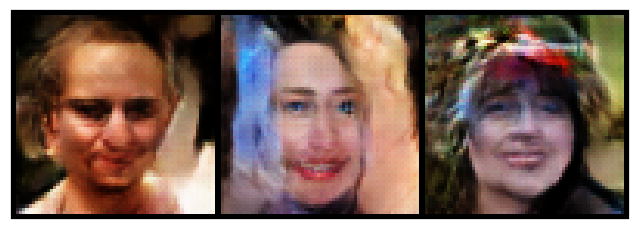

epoch: 55


  0%|          | 0/786 [00:00<?, ?it/s]

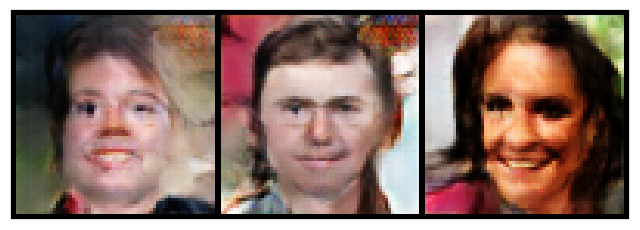

epoch: 56


  0%|          | 0/786 [00:00<?, ?it/s]

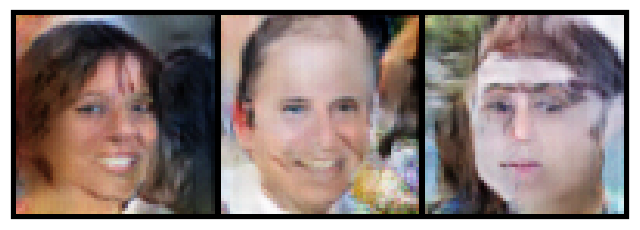

epoch: 57


  0%|          | 0/786 [00:00<?, ?it/s]

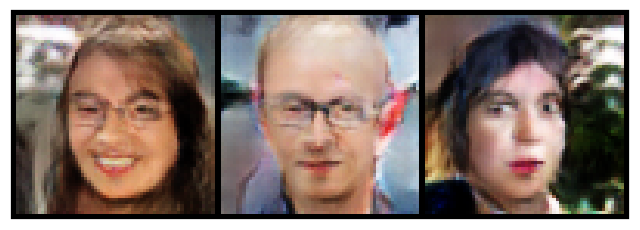

epoch: 58


  0%|          | 0/786 [00:00<?, ?it/s]

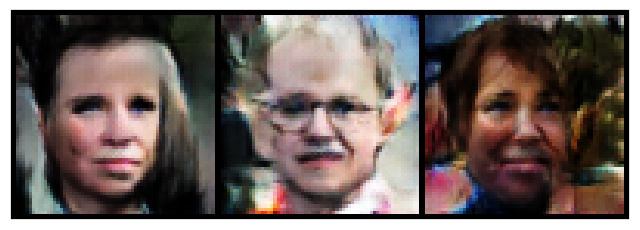

epoch: 59


  0%|          | 0/786 [00:00<?, ?it/s]

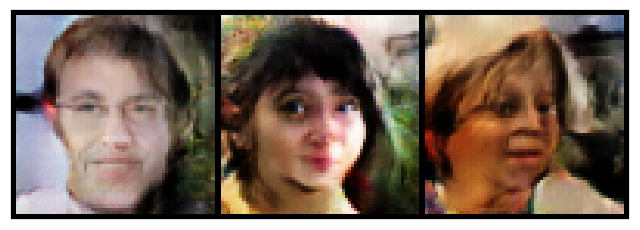

In [697]:
history2 = fit(model, criterion, optimizer, epochs=60, train_images_loader=train_images_loader)

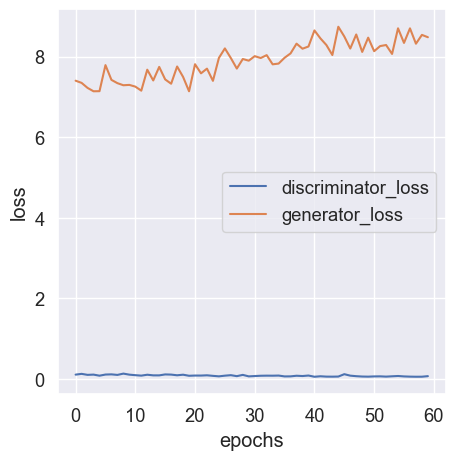

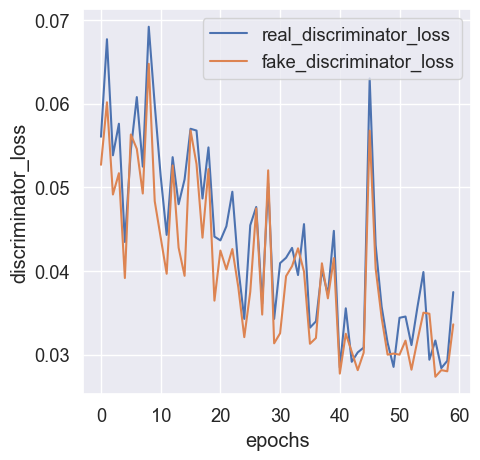

In [698]:
real_discriminator_loss, fake_discriminator_loss, discriminator_loss, generator_loss = zip(*history2)

plt.figure(figsize=(5, 5))
plt.plot(discriminator_loss, label="discriminator_loss")
plt.plot(generator_loss, label="generator_loss")
plt.legend(loc='best')
plt.xlabel("epochs")
plt.ylabel("loss")
plt.show()


plt.figure(figsize=(5, 5))
plt.plot(real_discriminator_loss, label="real_discriminator_loss")
plt.plot(fake_discriminator_loss, label="fake_discriminator_loss")
plt.legend(loc='best')
plt.xlabel("epochs")
plt.ylabel("discriminator_loss")
plt.show()

  0%|          | 0/60 [00:00<?, ?it/s]

epoch: 0


  0%|          | 0/786 [00:00<?, ?it/s]

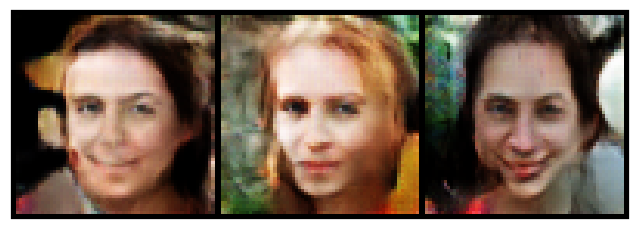

epoch: 1


  0%|          | 0/786 [00:00<?, ?it/s]

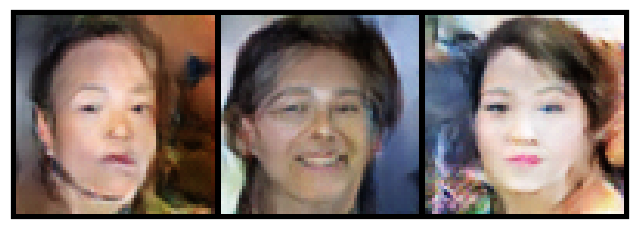

epoch: 2


  0%|          | 0/786 [00:00<?, ?it/s]

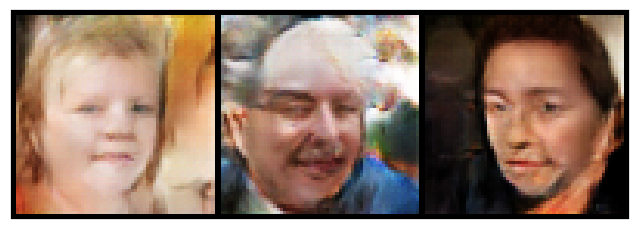

epoch: 3


  0%|          | 0/786 [00:00<?, ?it/s]

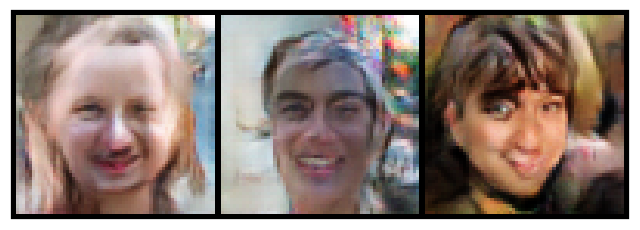

epoch: 4


  0%|          | 0/786 [00:00<?, ?it/s]

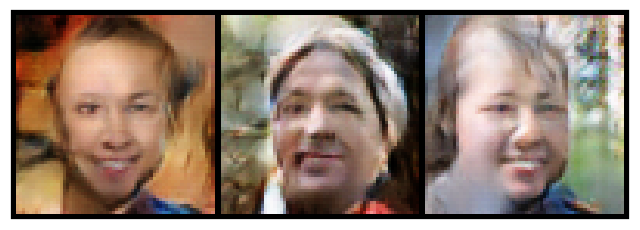

epoch: 5


  0%|          | 0/786 [00:00<?, ?it/s]

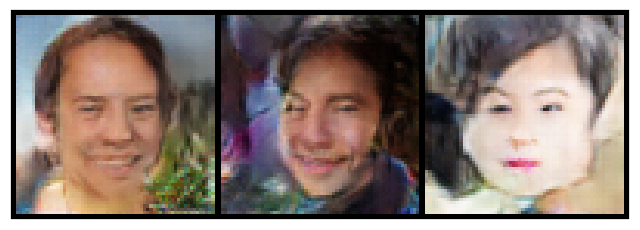

epoch: 6


  0%|          | 0/786 [00:00<?, ?it/s]

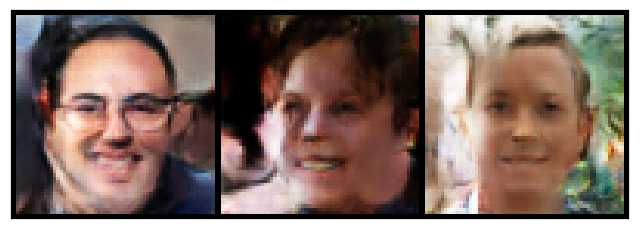

epoch: 7


  0%|          | 0/786 [00:00<?, ?it/s]

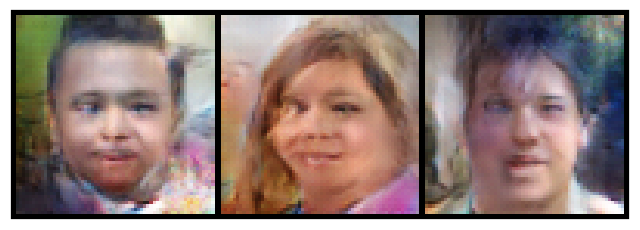

epoch: 8


  0%|          | 0/786 [00:00<?, ?it/s]

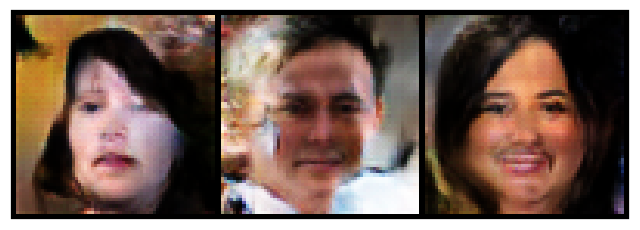

epoch: 9


  0%|          | 0/786 [00:00<?, ?it/s]

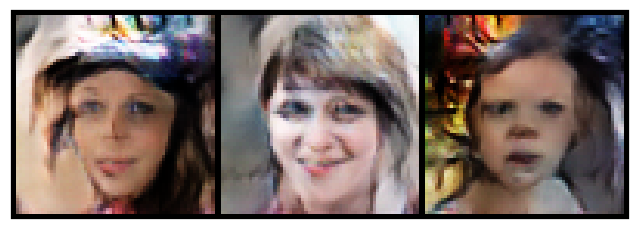

epoch: 10


  0%|          | 0/786 [00:00<?, ?it/s]

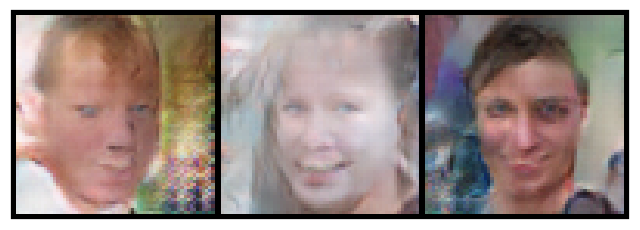

epoch: 11


  0%|          | 0/786 [00:00<?, ?it/s]

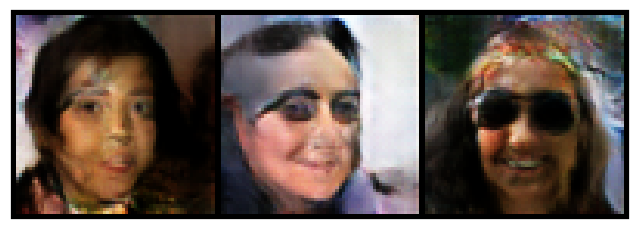

epoch: 12


  0%|          | 0/786 [00:00<?, ?it/s]

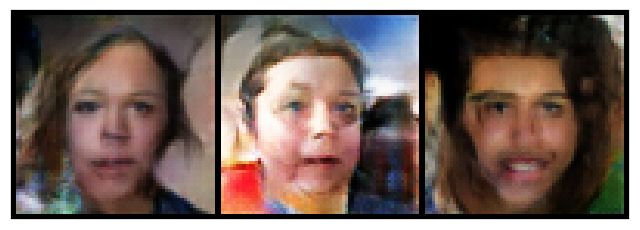

epoch: 13


  0%|          | 0/786 [00:00<?, ?it/s]

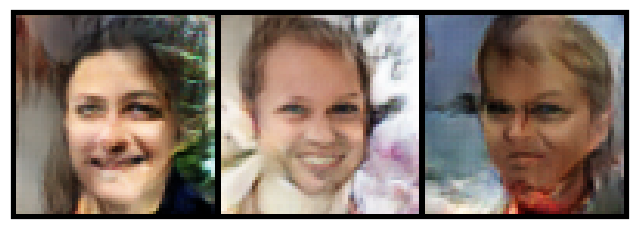

epoch: 14


  0%|          | 0/786 [00:00<?, ?it/s]

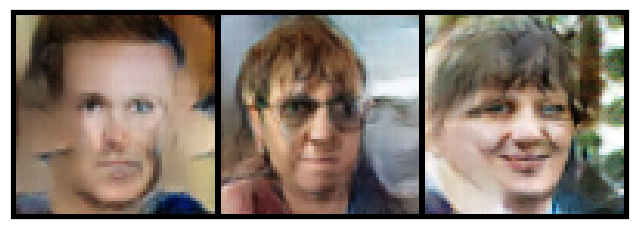

epoch: 15


  0%|          | 0/786 [00:00<?, ?it/s]

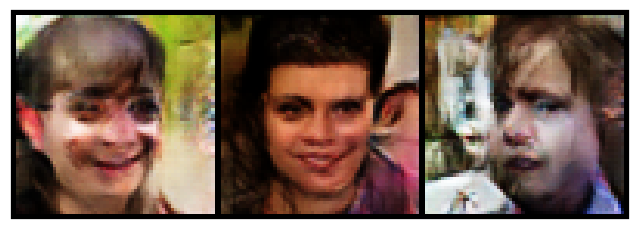

epoch: 16


  0%|          | 0/786 [00:00<?, ?it/s]

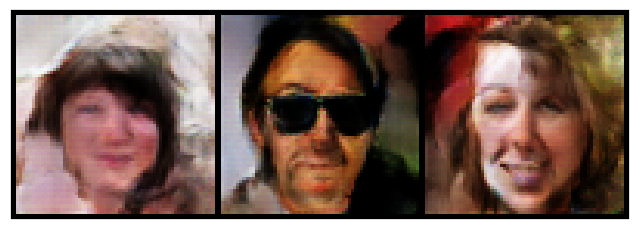

epoch: 17


  0%|          | 0/786 [00:00<?, ?it/s]

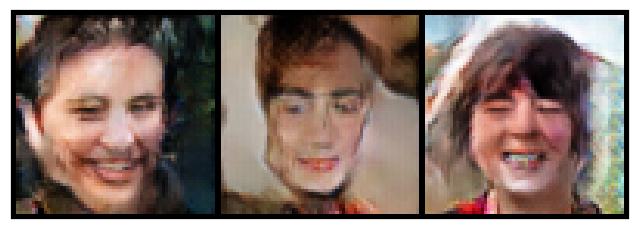

epoch: 18


  0%|          | 0/786 [00:00<?, ?it/s]

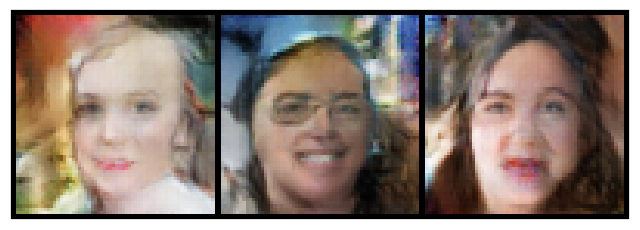

epoch: 19


  0%|          | 0/786 [00:00<?, ?it/s]

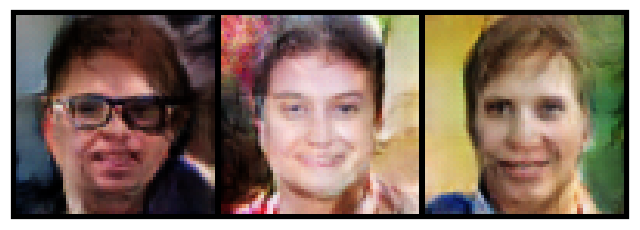

epoch: 20


  0%|          | 0/786 [00:00<?, ?it/s]

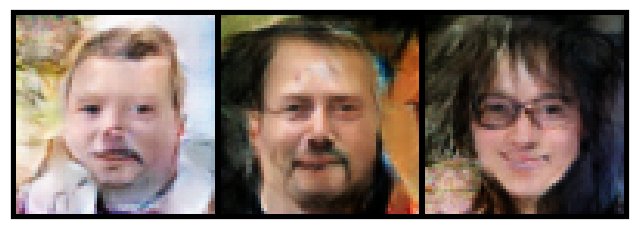

epoch: 21


  0%|          | 0/786 [00:00<?, ?it/s]

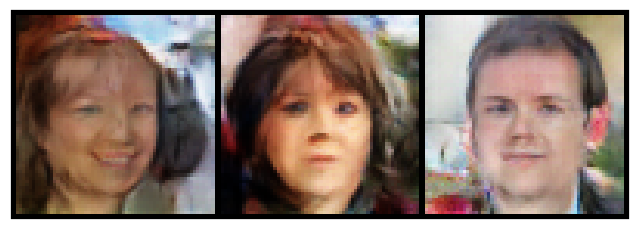

epoch: 22


  0%|          | 0/786 [00:00<?, ?it/s]

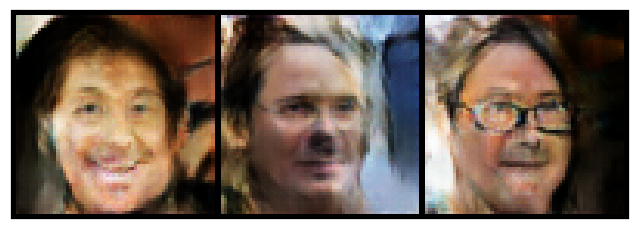

epoch: 23


  0%|          | 0/786 [00:00<?, ?it/s]

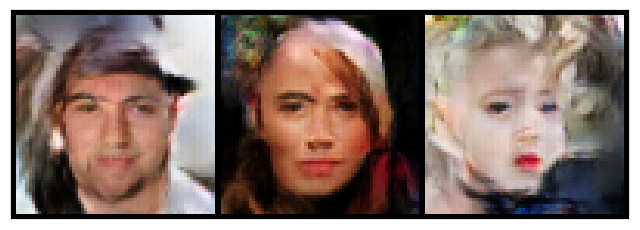

epoch: 24


  0%|          | 0/786 [00:00<?, ?it/s]

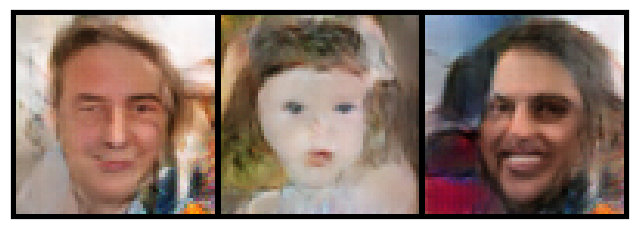

epoch: 25


  0%|          | 0/786 [00:00<?, ?it/s]

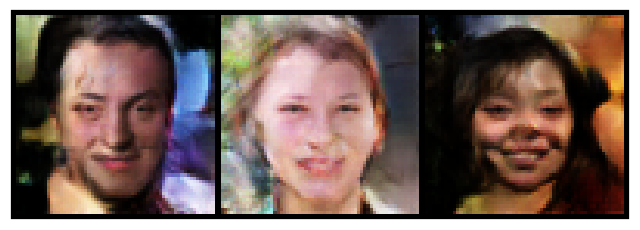

epoch: 26


  0%|          | 0/786 [00:00<?, ?it/s]

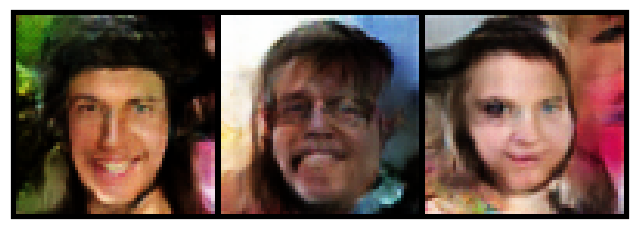

epoch: 27


  0%|          | 0/786 [00:00<?, ?it/s]

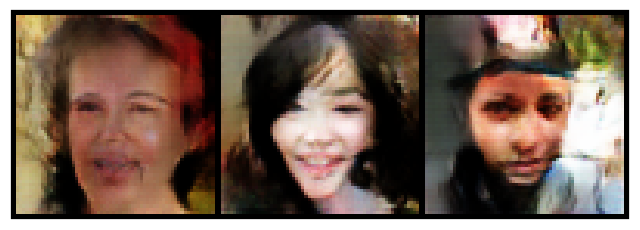

epoch: 28


  0%|          | 0/786 [00:00<?, ?it/s]

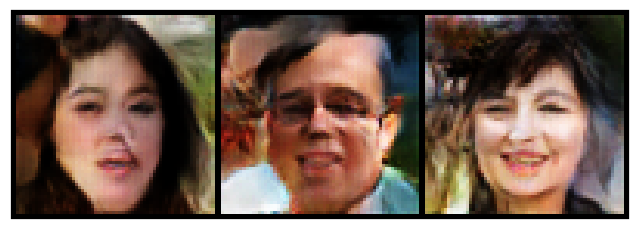

epoch: 29


  0%|          | 0/786 [00:00<?, ?it/s]

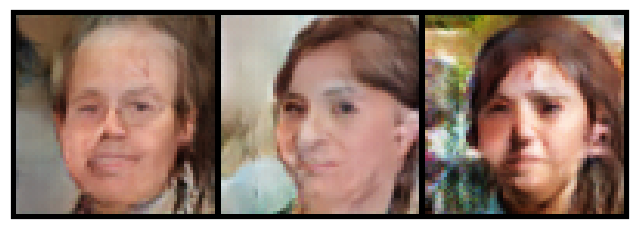

epoch: 30


  0%|          | 0/786 [00:00<?, ?it/s]

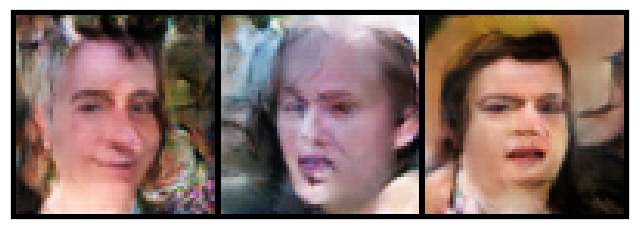

epoch: 31


  0%|          | 0/786 [00:00<?, ?it/s]

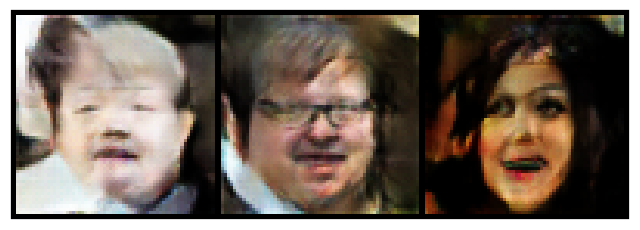

epoch: 32


  0%|          | 0/786 [00:00<?, ?it/s]

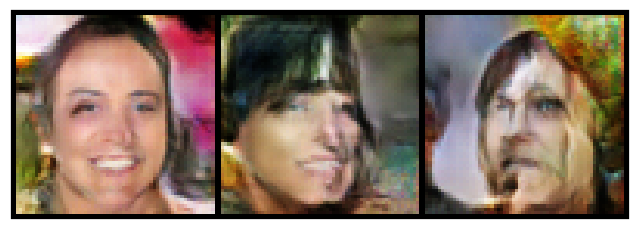

epoch: 33


  0%|          | 0/786 [00:00<?, ?it/s]

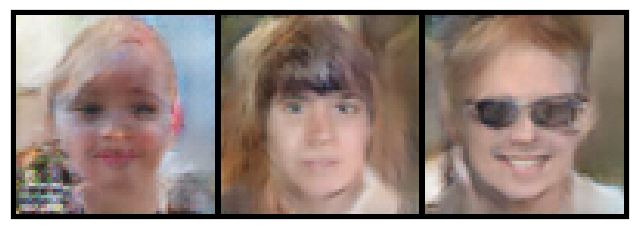

epoch: 34


  0%|          | 0/786 [00:00<?, ?it/s]

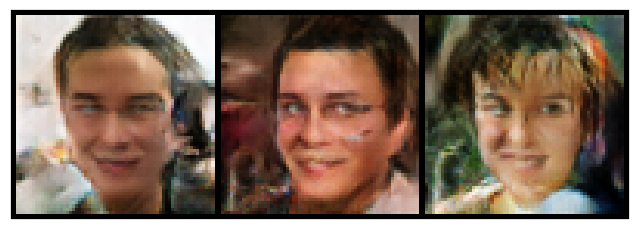

epoch: 35


  0%|          | 0/786 [00:00<?, ?it/s]

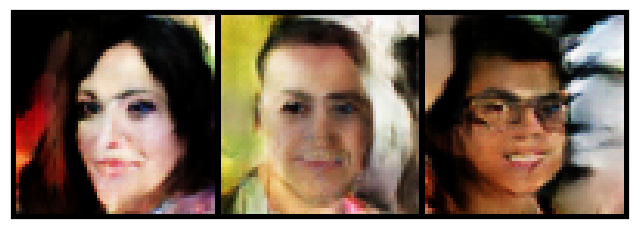

epoch: 36


  0%|          | 0/786 [00:00<?, ?it/s]

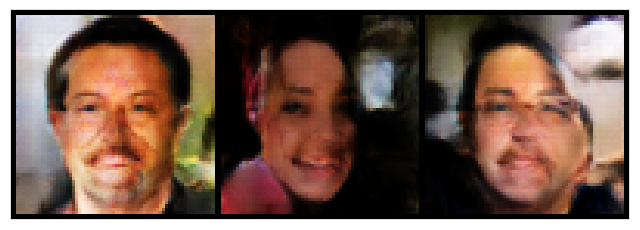

epoch: 37


  0%|          | 0/786 [00:00<?, ?it/s]

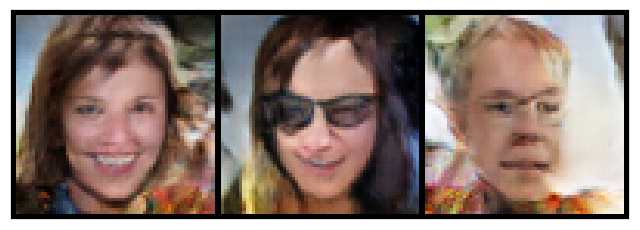

epoch: 38


  0%|          | 0/786 [00:00<?, ?it/s]

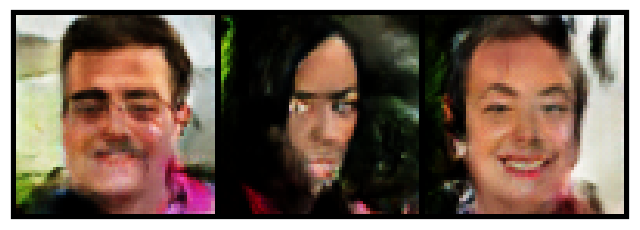

epoch: 39


  0%|          | 0/786 [00:00<?, ?it/s]

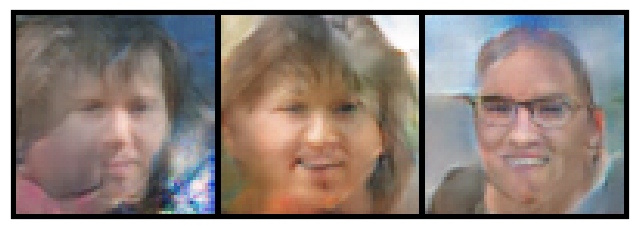

epoch: 40


  0%|          | 0/786 [00:00<?, ?it/s]

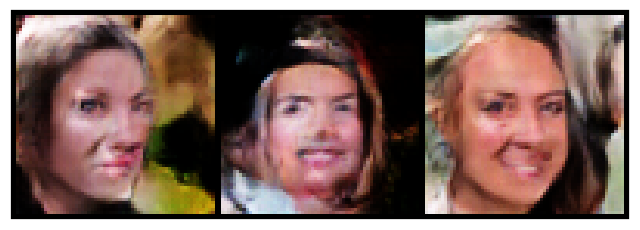

epoch: 41


  0%|          | 0/786 [00:00<?, ?it/s]

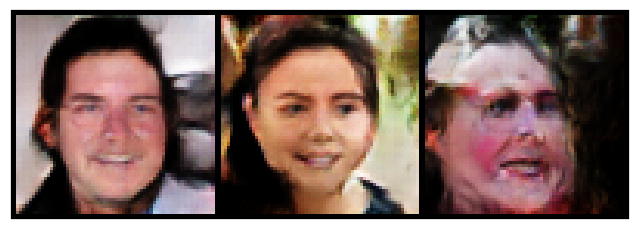

epoch: 42


  0%|          | 0/786 [00:00<?, ?it/s]

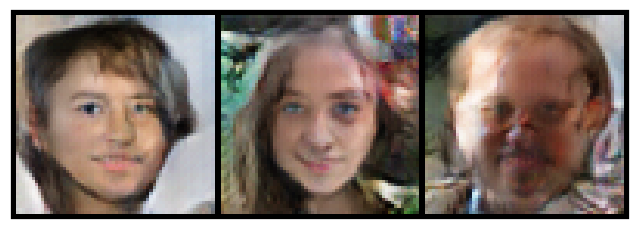

epoch: 43


  0%|          | 0/786 [00:00<?, ?it/s]

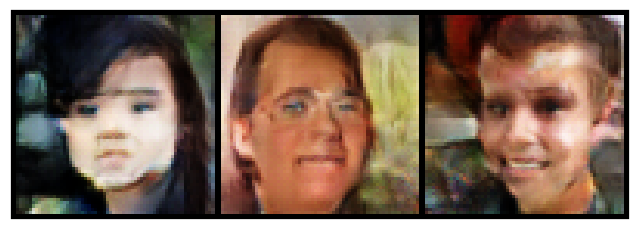

epoch: 44


  0%|          | 0/786 [00:00<?, ?it/s]

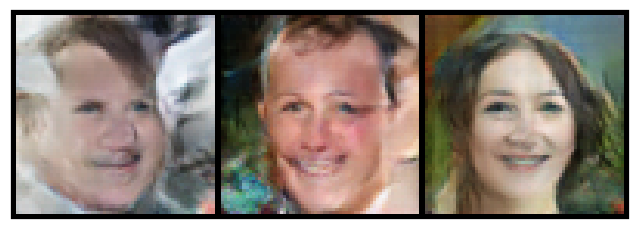

epoch: 45


  0%|          | 0/786 [00:00<?, ?it/s]

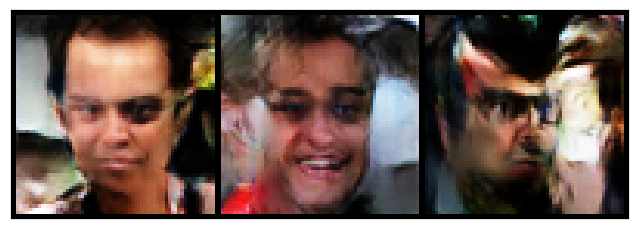

epoch: 46


  0%|          | 0/786 [00:00<?, ?it/s]

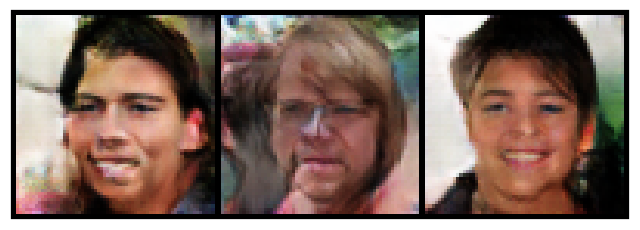

epoch: 47


  0%|          | 0/786 [00:00<?, ?it/s]

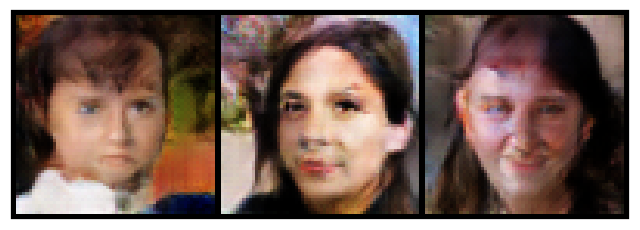

epoch: 48


  0%|          | 0/786 [00:00<?, ?it/s]

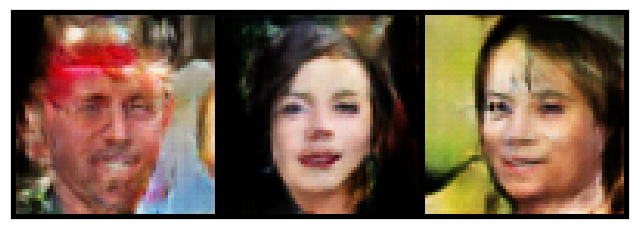

epoch: 49


  0%|          | 0/786 [00:00<?, ?it/s]

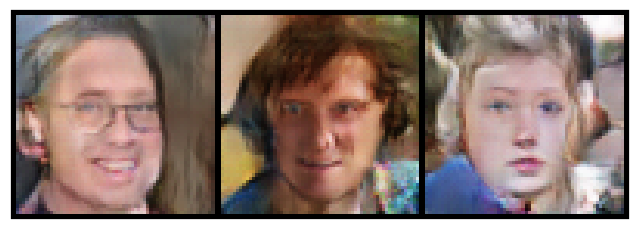

epoch: 50


  0%|          | 0/786 [00:00<?, ?it/s]

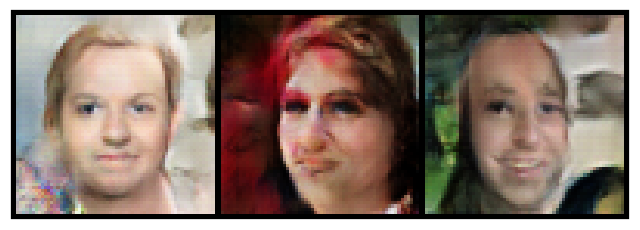

epoch: 51


  0%|          | 0/786 [00:00<?, ?it/s]

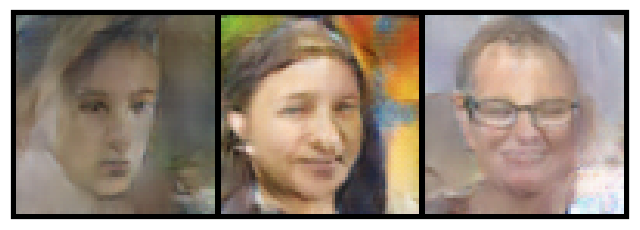

epoch: 52


  0%|          | 0/786 [00:00<?, ?it/s]

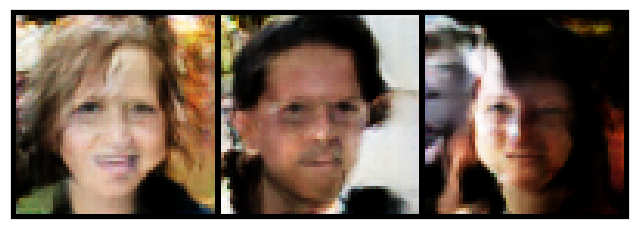

epoch: 53


  0%|          | 0/786 [00:00<?, ?it/s]

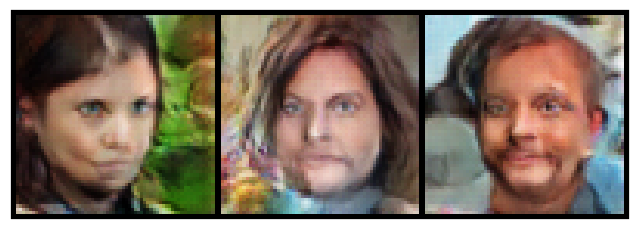

epoch: 54


  0%|          | 0/786 [00:00<?, ?it/s]

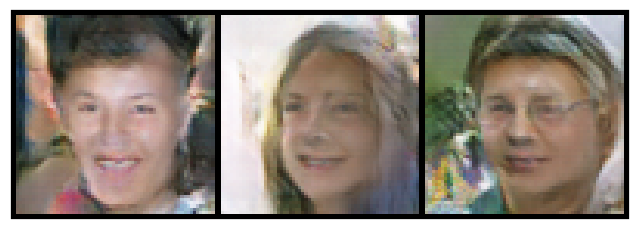

epoch: 55


  0%|          | 0/786 [00:00<?, ?it/s]

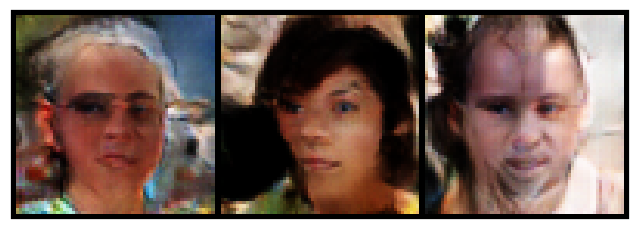

epoch: 56


  0%|          | 0/786 [00:00<?, ?it/s]

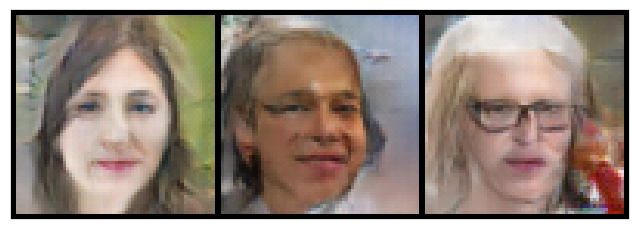

epoch: 57


  0%|          | 0/786 [00:00<?, ?it/s]

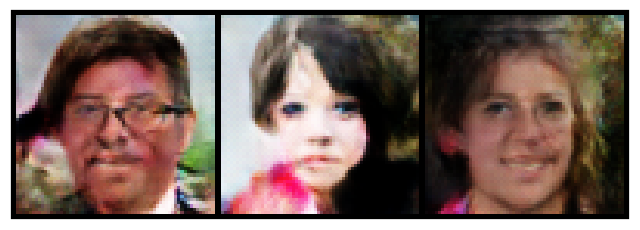

epoch: 58


  0%|          | 0/786 [00:00<?, ?it/s]

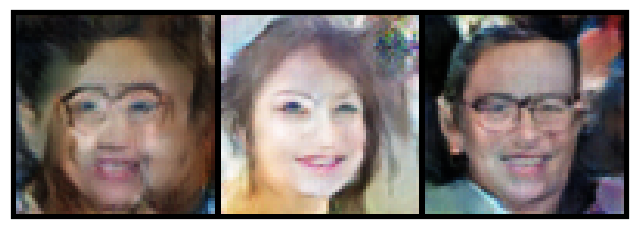

epoch: 59


  0%|          | 0/786 [00:00<?, ?it/s]

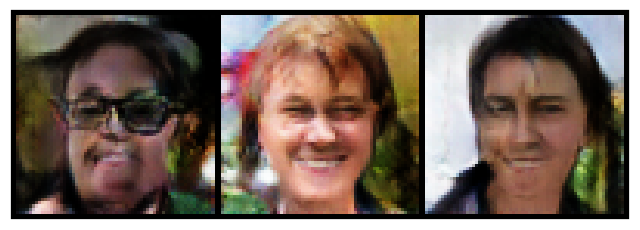

In [699]:
history3 = fit(model, criterion, optimizer, epochs=60, train_images_loader=train_images_loader)

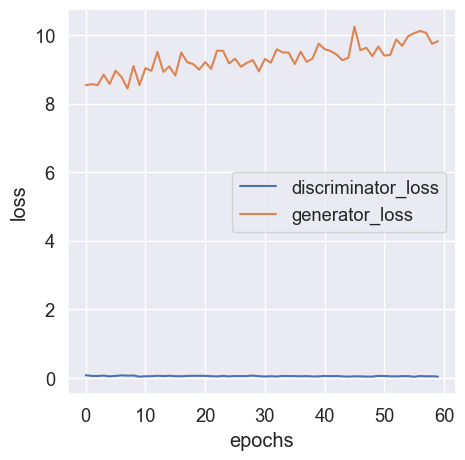

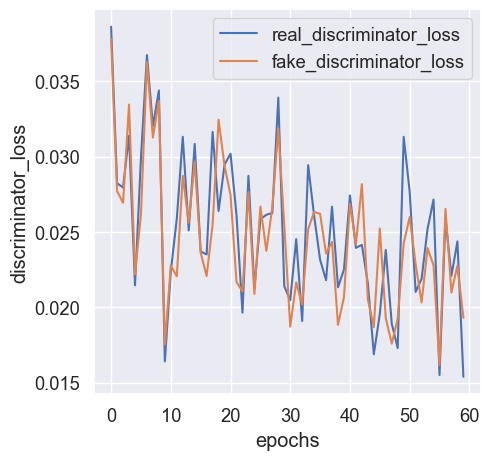

In [700]:
real_discriminator_loss, fake_discriminator_loss, discriminator_loss, generator_loss = zip(*history3)

plt.figure(figsize=(5, 5))
plt.plot(discriminator_loss, label="discriminator_loss")
plt.plot(generator_loss, label="generator_loss")
plt.legend(loc='best')
plt.xlabel("epochs")
plt.ylabel("loss")
plt.show()


plt.figure(figsize=(5, 5))
plt.plot(real_discriminator_loss, label="real_discriminator_loss")
plt.plot(fake_discriminator_loss, label="fake_discriminator_loss")
plt.legend(loc='best')
plt.xlabel("epochs")
plt.ylabel("discriminator_loss")
plt.show()

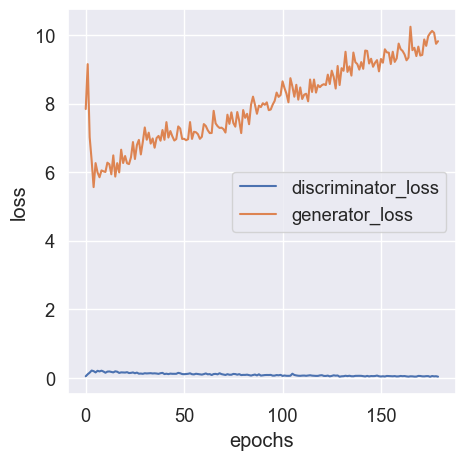

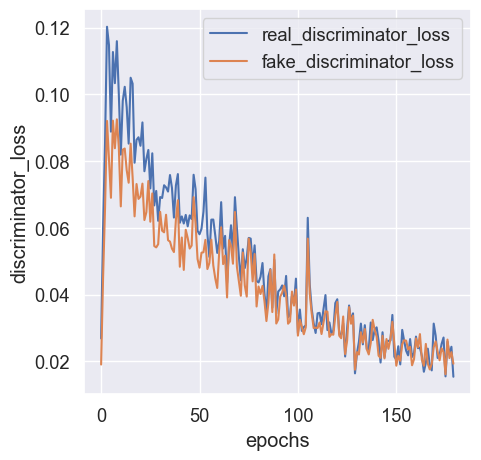

In [713]:
all_history = np.concatenate([np.array(history), np.array(history2), np.array(history3)])

real_discriminator_loss, fake_discriminator_loss, discriminator_loss, generator_loss = zip(*list(all_history))

plt.figure(figsize=(5, 5))
plt.plot(discriminator_loss, label="discriminator_loss")
plt.plot(generator_loss, label="generator_loss")
plt.legend(loc='best')
plt.xlabel("epochs")
plt.ylabel("loss")
plt.show()


plt.figure(figsize=(5, 5))
plt.plot(real_discriminator_loss, label="real_discriminator_loss")
plt.plot(fake_discriminator_loss, label="fake_discriminator_loss")
plt.legend(loc='best')
plt.xlabel("epochs")
plt.ylabel("discriminator_loss")
plt.show()

In [701]:
# Сохраним обе модели 
def save_models(model):
    torch.save(model["discriminator"], "discriminator_model.pth")
    torch.save(model["generator"], "generator_model.pth")
    
save_models(model)

  0%|          | 0/786 [00:00<?, ?it/s]

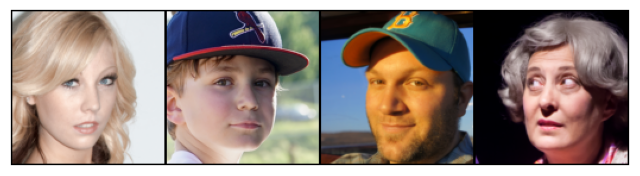

In [98]:
# Выведем реальные фото 
for img_batch, classes in tqdm(train_images_loader):
    real_img_batch = img_batch
    
    fig, ax = plt.subplots(figsize=(8, 8))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denormalize(img_batch.cpu().detach()), nrow=8).permute(1, 2, 0))
    plt.show()
    break
    

torch.Size([4, 3, 64, 64])
torch.Size([4, 3, 128, 128])


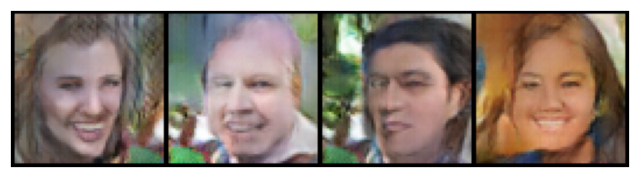

In [714]:
# Выведем фейковые изображения
fixed_latent = torch.randn(batch_size, latent_size, 1, 1, device=device)
fake_images = model["generator"](fixed_latent)

fig, ax = plt.subplots(figsize=(8, 8))
ax.set_xticks([]); ax.set_yticks([])
ax.imshow(make_grid(denormalize(fake_images.cpu().detach()), nrow=8).permute(1, 2, 0))
plt.show()

Постройте графики лосса для генератора и дискриминатора. Что вы можете сказать про эти графики?

## Часть 3. Генерация изображений (1 балл)

Теперь давайте оценим качество получившихся изображений. Напишите функцию, которая выводит изображения, сгенерированные нашим генератором

In [722]:
n_images = 4

fixed_latent = torch.randn(n_images, latent_size, 1, 1, device=device)
fake_images = model["generator"](fixed_latent)

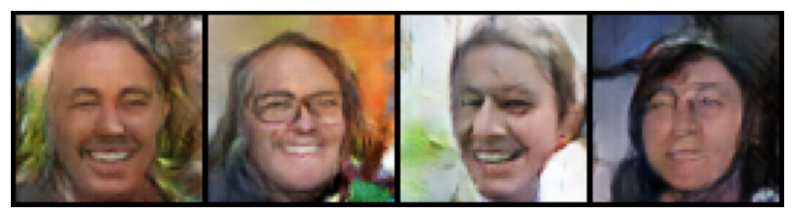

In [836]:
# Сделаем метод для вывода изображений
def show_images(generated, nrow=8):
    fig, ax = plt.subplots(figsize=(10, 10))
    ax.set_xticks([]); ax.set_yticks([])
    ax.imshow(make_grid(denormalize(generated.cpu().detach()), nrow=nrow).permute(1, 2, 0))
    plt.show()
show_images(fake_images, nrow=8)

Как вам качество получившихся изображений?

##### Ответ
Качество конечно ужасное, но сравнивая последние и первые эпохи можно точно сказать, что это работает! =)
Для получения более лучшего качетсва надо побольше разных трюков попробовать поприменять

## Часть 4. Leave-one-out-1-NN classifier accuracy (6 баллов)

### 4.1. Подсчет accuracy (4 балла)

Не всегда бывает удобно оценивать качество сгенерированных картинок глазами. В качестве альтернативы вам предлагается реализовать следующий подход:
  * Сгенерировать столько же фейковых изображений, сколько есть настоящих в обучающей выборке. Присвоить фейковым метку класса 0, настоящим – 1.
  * Построить leave-one-out оценку: обучить 1NN Classifier (`sklearn.neighbors.KNeighborsClassifier(n_neighbors=1)`) предсказывать класс на всех объектах, кроме одного, проверить качество (accuracy) на оставшемся объекте. В этом вам поможет `sklearn.model_selection.LeaveOneOut`

In [815]:
# Сделаем датасет с фейковыми картинками  
class FakeDataSetImages(Dataset):
    def __init__(self, gen_model, device, latent_size, total_fakeimg=1000):
        self.total_fakeimg = total_fakeimg
        self.gen_model = gen_model
        self.device = device
        self.latent_size = latent_size

    def __len__(self):
        return self.total_fakeimg

    def __getitem__(self, idx):
        fixed_latent = torch.randn(1, self.latent_size, 1, 1, device=self.device)
        fake_images = self.gen_model(fixed_latent)
        tensor_image = fake_images.cpu().detach()[0]
#         tensor_image = tensor_image.permute(1, 2, 0)
        label = 1
        return tensor_image, label
    
fake_images_ds = FakeDataSetImages(gen_model=model["generator"], device=device, latent_size=latent_size, total_fakeimg=len(train_images_ds))


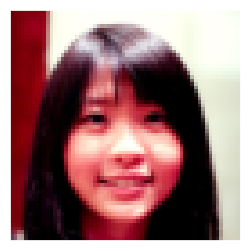

In [835]:
# for tmp in train_images_ds:
    
#     fig, ax = plt.subplots(figsize=(3, 3))
#     ax.set_xticks([]); ax.set_yticks([])
#     ax.imshow(denormalize(tmp[0]).permute(1, 2, 0))
    
#     plt.show()    
#     break

In [913]:
# Объединим датасеты реальных и фейковых изображений. Затем подготовим перемешанные тренировочный и тестовый датасеты
from torch.utils.data import random_split

# Объединяем датасет реальных фото с датасетом сгенерированных фото
datasets = [train_images_ds, fake_images_ds]
# len(train_images_ds)
union_dataset = ConcatDataset(datasets)
# Делим на трайн и тест 
train_dataset, test_dataset = random_split(union_dataset, [0.9, 0.1])

train_union_loader = DataLoader(train_dataset, batch_size=500, shuffle=True, pin_memory=True, drop_last=True)
test_union_loader = DataLoader(test_dataset, batch_size=8, shuffle=True, pin_memory=True, drop_last=True)

tensor([1, 0, 1, 1, 0, 1, 1, 0])


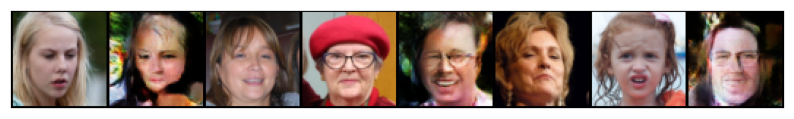

In [851]:
# Выведем один пакет изображений из лоадера 
# По умолчанию: label: 0 - реальное фото, 1 - сгенерированное изображение
# Для более понятной интерпретации меянем 1 и 0
for batch_images, label in test_union_loader:
    label = 1-label
    print(label)
    show_images(batch_images)
    break

In [914]:
# Оценка качества сгенерированных картинок через KNN
from sklearn.neighbors import KNeighborsClassifier

knn_model = KNeighborsClassifier(n_neighbors=1)
x, y = None, np.array([])
for batch_images, label in tqdm(train_union_loader):
    label = 1-label
    flatten_batch_images = torch.flatten(batch_images, start_dim=1)
    if x is None:
        x = flatten_batch_images.numpy()
        y = label.numpy()
    else:
        x = np.vstack((x,flatten_batch_images.numpy()))
        y = np.append(y, label.numpy())
print(x.shape)
print(y.shape)
# Обучаем KNN
knn_model.fit(x, y)

  0%|          | 0/11 [00:00<?, ?it/s]

(5500, 12288)
(5500,)


  0%|          | 0/78 [00:00<?, ?it/s]

pred_label: [1 1 1 0 0 1 0 1]
real_label: [0 1 1 0 0 1 0 1]
f1_score: 0.888888888888889
accuracy_score: 0.875


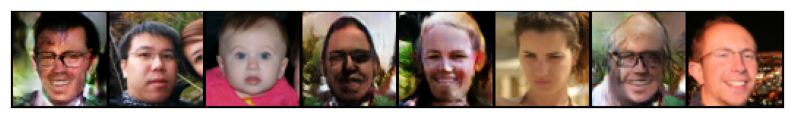

pred_label: [0 1 1 1 1 0 1 1]
real_label: [0 1 1 1 1 0 1 1]
f1_score: 1.0
accuracy_score: 1.0


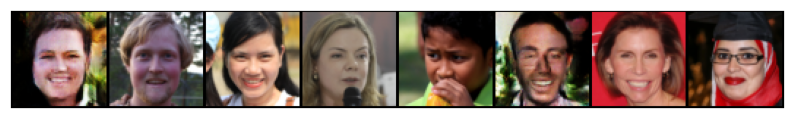

pred_label: [1 1 0 1 1 1 0 1]
real_label: [0 0 0 1 1 1 0 1]
f1_score: 0.8
accuracy_score: 0.75


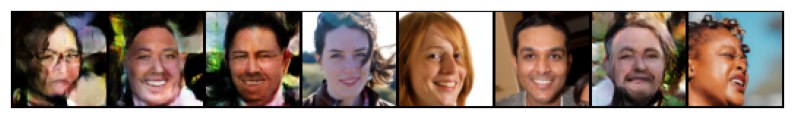

pred_label: [1 1 1 1 1 1 0 1]
real_label: [0 1 1 1 1 0 0 1]
f1_score: 0.8333333333333333
accuracy_score: 0.75


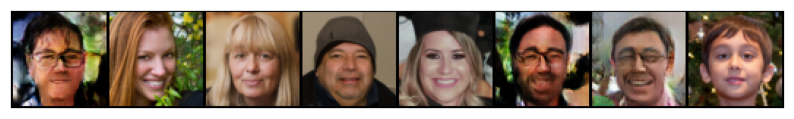

pred_label: [0 1 0 0 1 0 1 0]
real_label: [0 1 0 0 0 0 1 0]
f1_score: 0.8
accuracy_score: 0.875


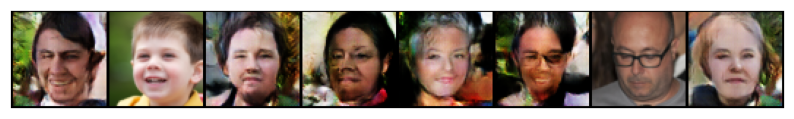

pred_label: [1 1 1 0 0 0 1 1]
real_label: [1 0 0 0 0 0 1 1]
f1_score: 0.7499999999999999
accuracy_score: 0.75


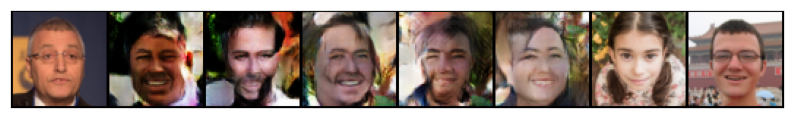

pred_label: [1 0 1 1 0 0 1 0]
real_label: [1 0 0 1 0 0 0 0]
f1_score: 0.6666666666666666
accuracy_score: 0.75


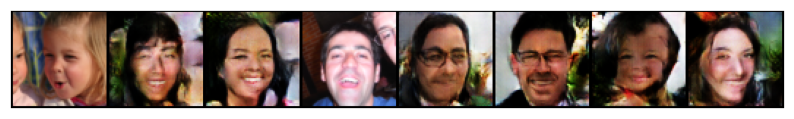

pred_label: [0 0 0 0 0 1 1 1]
real_label: [0 0 0 0 0 1 0 1]
f1_score: 0.8
accuracy_score: 0.875


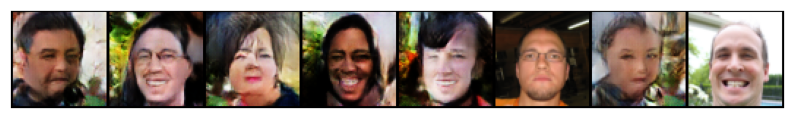

pred_label: [1 0 1 0 0 0 1 0]
real_label: [0 0 1 0 0 0 1 0]
f1_score: 0.8
accuracy_score: 0.875


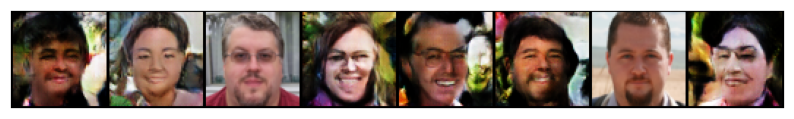

pred_label: [0 0 1 1 1 1 1 1]
real_label: [0 0 1 0 1 0 1 1]
f1_score: 0.8
accuracy_score: 0.75


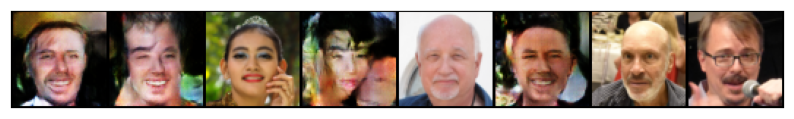

pred_label: [0 1 0 0 1 0 1 1]
real_label: [0 0 0 1 0 0 1 1]
f1_score: 0.5714285714285715
accuracy_score: 0.625


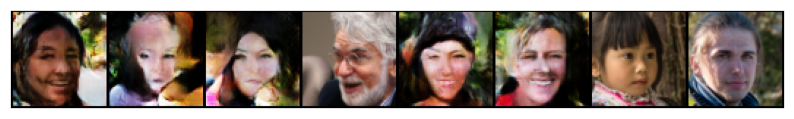

pred_label: [1 0 0 1 0 0 1 0]
real_label: [1 0 0 0 0 0 1 0]
f1_score: 0.8
accuracy_score: 0.875


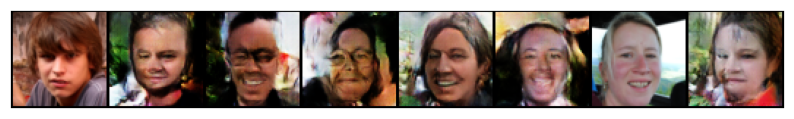

pred_label: [0 1 0 1 1 1 0 1]
real_label: [0 1 0 1 1 1 0 1]
f1_score: 1.0
accuracy_score: 1.0


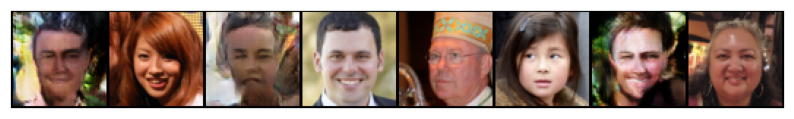

pred_label: [1 1 0 1 0 0 1 1]
real_label: [1 1 0 1 0 0 1 0]
f1_score: 0.888888888888889
accuracy_score: 0.875


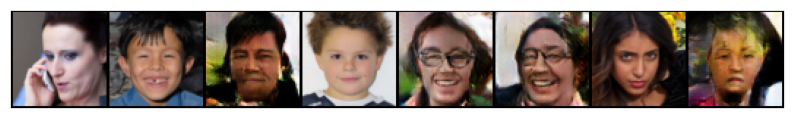

pred_label: [1 0 1 1 1 1 0 0]
real_label: [1 0 1 1 1 1 0 0]
f1_score: 1.0
accuracy_score: 1.0


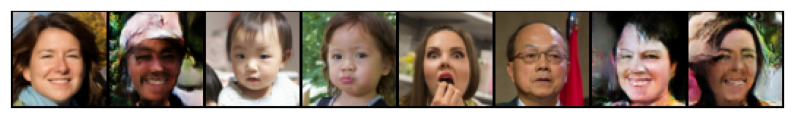

pred_label: [1 1 1 0 0 1 0 0]
real_label: [1 1 1 0 0 1 0 0]
f1_score: 1.0
accuracy_score: 1.0


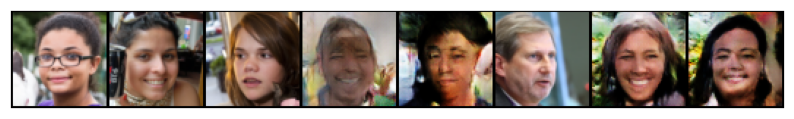

pred_label: [0 1 1 1 1 0 1 1]
real_label: [0 0 1 1 1 0 1 1]
f1_score: 0.9090909090909091
accuracy_score: 0.875


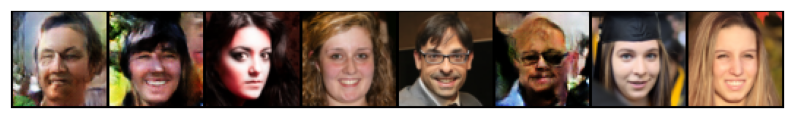

pred_label: [1 1 1 1 0 1 1 0]
real_label: [1 1 1 1 0 1 1 0]
f1_score: 1.0
accuracy_score: 1.0


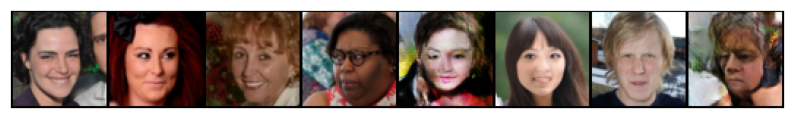

pred_label: [1 1 1 1 0 1 1 1]
real_label: [1 1 1 0 0 0 1 1]
f1_score: 0.8333333333333333
accuracy_score: 0.75


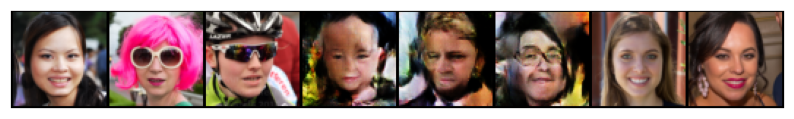

pred_label: [0 0 0 0 1 0 1 1]
real_label: [0 1 0 0 0 0 1 1]
f1_score: 0.6666666666666666
accuracy_score: 0.75


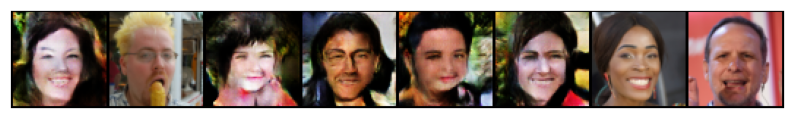

pred_label: [1 1 0 1 0 0 1 1]
real_label: [1 1 0 1 0 0 0 1]
f1_score: 0.888888888888889
accuracy_score: 0.875


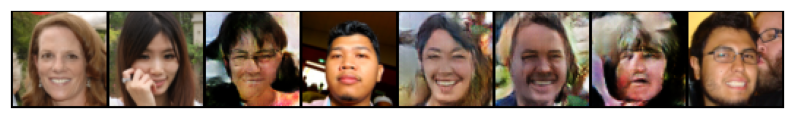

pred_label: [1 1 0 0 1 0 1 1]
real_label: [1 0 0 0 0 0 1 0]
f1_score: 0.5714285714285715
accuracy_score: 0.625


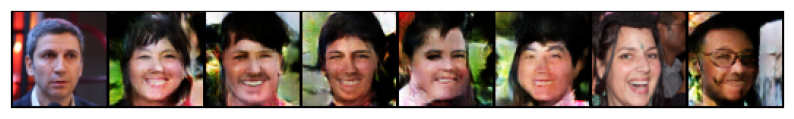

pred_label: [1 1 1 1 1 1 1 1]
real_label: [1 1 1 0 1 1 1 1]
f1_score: 0.9333333333333333
accuracy_score: 0.875


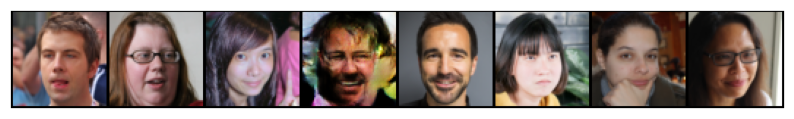

pred_label: [1 0 1 1 1 0 1 0]
real_label: [1 1 1 1 0 0 0 0]
f1_score: 0.6666666666666665
accuracy_score: 0.625


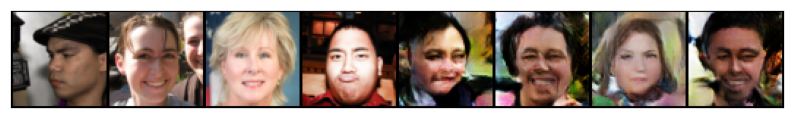

pred_label: [1 1 1 1 1 1 0 1]
real_label: [0 0 1 1 0 0 1 0]
f1_score: 0.4
accuracy_score: 0.25


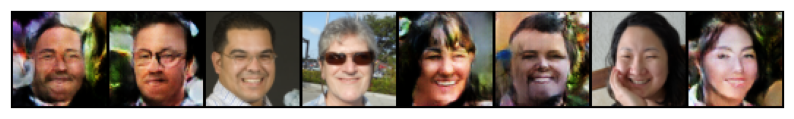

pred_label: [0 1 1 1 0 0 1 0]
real_label: [0 1 1 1 0 0 1 0]
f1_score: 1.0
accuracy_score: 1.0


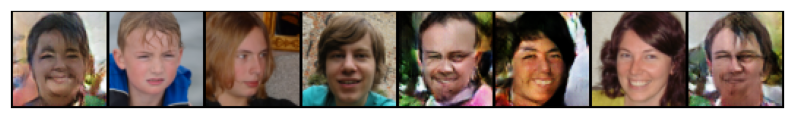

pred_label: [1 0 1 1 1 1 0 1]
real_label: [1 0 1 1 1 1 1 1]
f1_score: 0.923076923076923
accuracy_score: 0.875


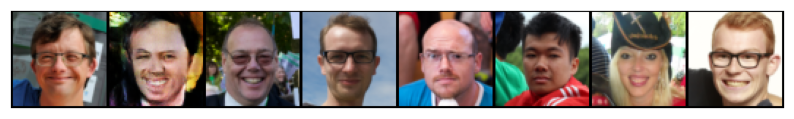

pred_label: [1 1 0 0 0 1 1 1]
real_label: [1 0 0 0 0 1 1 0]
f1_score: 0.7499999999999999
accuracy_score: 0.75


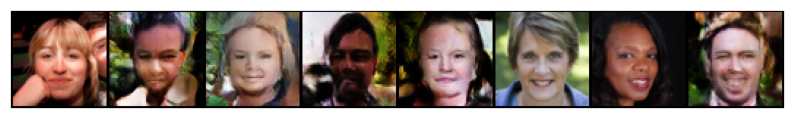

pred_label: [1 0 1 1 1 1 1 1]
real_label: [1 0 1 1 1 1 1 1]
f1_score: 1.0
accuracy_score: 1.0


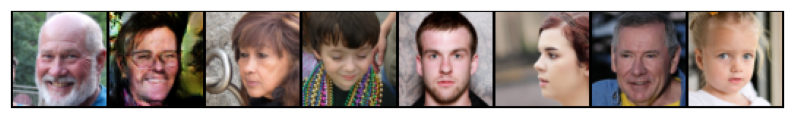

pred_label: [1 0 0 0 0 0 0 0]
real_label: [1 0 0 0 0 0 0 0]
f1_score: 1.0
accuracy_score: 1.0


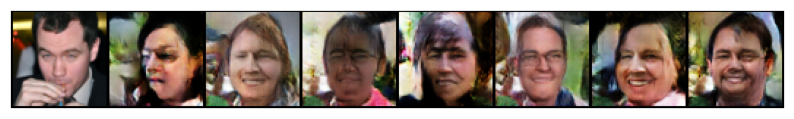

pred_label: [0 0 1 1 1 1 1 1]
real_label: [0 0 1 1 1 1 0 1]
f1_score: 0.9090909090909091
accuracy_score: 0.875


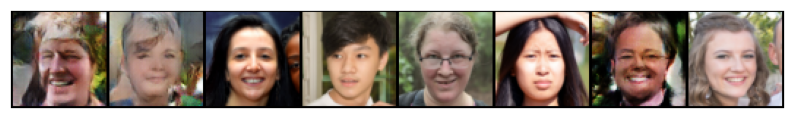

pred_label: [1 1 0 1 0 1 1 1]
real_label: [0 1 0 0 0 0 1 1]
f1_score: 0.6666666666666666
accuracy_score: 0.625


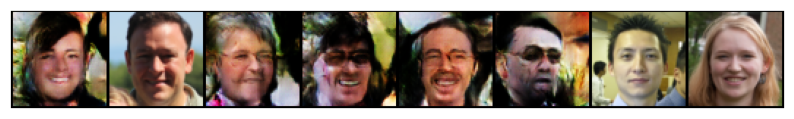

pred_label: [1 1 1 1 1 1 1 1]
real_label: [1 0 0 1 1 1 1 1]
f1_score: 0.8571428571428571
accuracy_score: 0.75


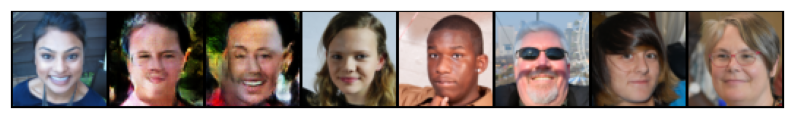

pred_label: [0 1 1 1 0 1 1 1]
real_label: [0 1 1 1 0 1 1 1]
f1_score: 1.0
accuracy_score: 1.0


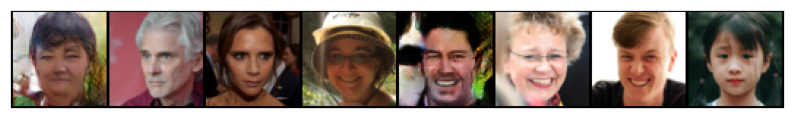

pred_label: [0 1 1 1 1 1 1 1]
real_label: [1 1 0 0 0 1 1 1]
f1_score: 0.6666666666666666
accuracy_score: 0.5


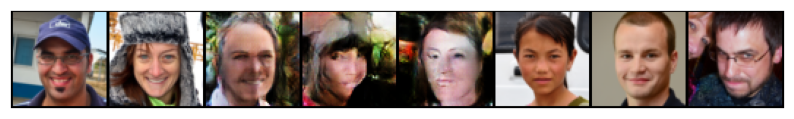

pred_label: [1 1 1 1 1 1 1 1]
real_label: [0 0 1 0 1 1 0 1]
f1_score: 0.6666666666666666
accuracy_score: 0.5


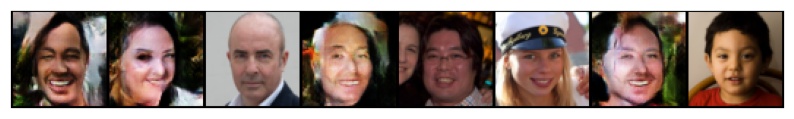

pred_label: [1 1 1 1 0 1 1 1]
real_label: [0 1 1 1 0 1 0 1]
f1_score: 0.8333333333333333
accuracy_score: 0.75


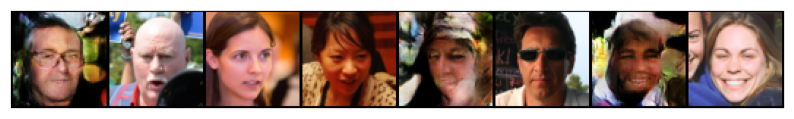

pred_label: [0 1 1 1 1 0 1 0]
real_label: [0 1 1 1 1 0 1 1]
f1_score: 0.9090909090909091
accuracy_score: 0.875


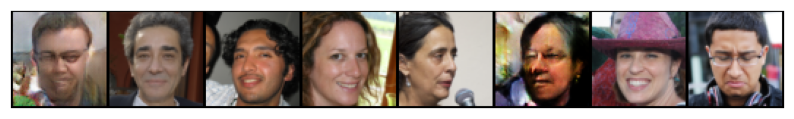

pred_label: [1 1 1 1 1 0 0 0]
real_label: [1 1 1 1 1 0 0 0]
f1_score: 1.0
accuracy_score: 1.0


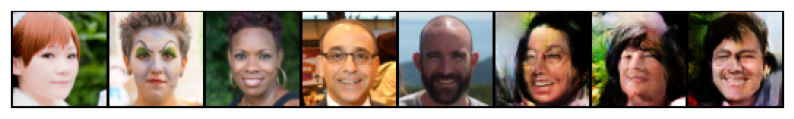

pred_label: [1 0 1 1 0 1 0 0]
real_label: [1 0 1 0 0 0 0 1]
f1_score: 0.5714285714285715
accuracy_score: 0.625


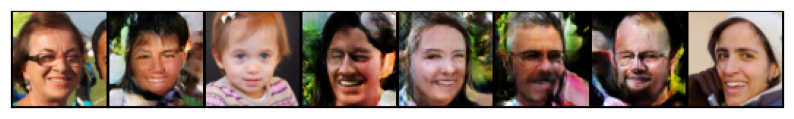

pred_label: [0 1 1 1 1 0 0 1]
real_label: [0 0 1 1 1 0 0 0]
f1_score: 0.7499999999999999
accuracy_score: 0.75


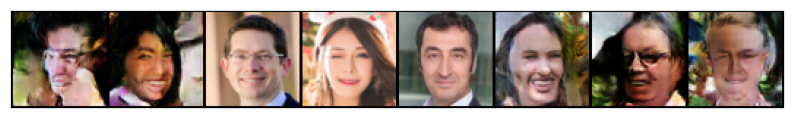

pred_label: [1 1 1 1 0 1 1 1]
real_label: [0 1 0 0 0 1 0 1]
f1_score: 0.6
accuracy_score: 0.5


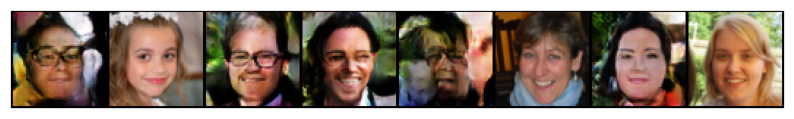

pred_label: [1 0 1 1 1 1 0 0]
real_label: [1 0 1 1 1 1 0 0]
f1_score: 1.0
accuracy_score: 1.0


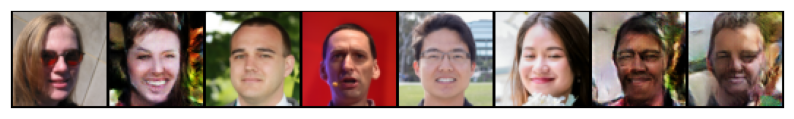

pred_label: [1 1 0 1 0 1 0 0]
real_label: [1 0 1 1 0 0 0 0]
f1_score: 0.5714285714285715
accuracy_score: 0.625


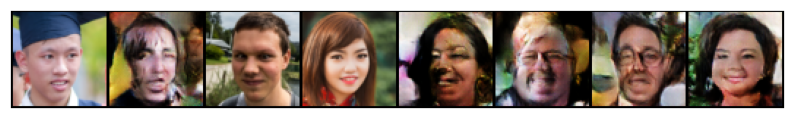

pred_label: [1 1 1 1 1 0 0 1]
real_label: [0 0 1 1 1 0 0 1]
f1_score: 0.8
accuracy_score: 0.75


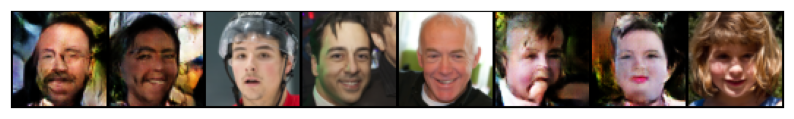

pred_label: [1 1 0 1 1 1 1 0]
real_label: [0 0 0 1 1 1 1 0]
f1_score: 0.8
accuracy_score: 0.75


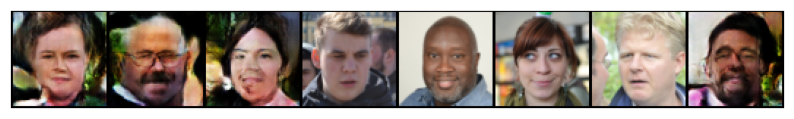

pred_label: [0 0 0 1 1 1 1 1]
real_label: [0 0 0 1 1 1 0 1]
f1_score: 0.888888888888889
accuracy_score: 0.875


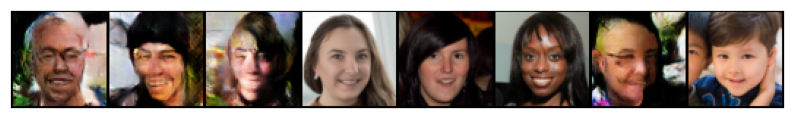

pred_label: [1 1 0 0 0 1 0 1]
real_label: [1 1 0 0 0 0 0 1]
f1_score: 0.8571428571428571
accuracy_score: 0.875


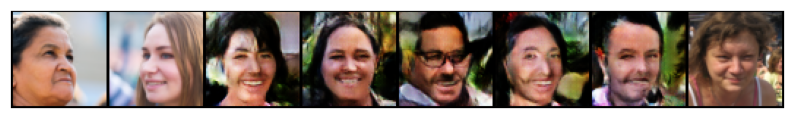

pred_label: [1 1 1 0 1 0 0 1]
real_label: [1 1 0 0 1 0 0 0]
f1_score: 0.7499999999999999
accuracy_score: 0.75


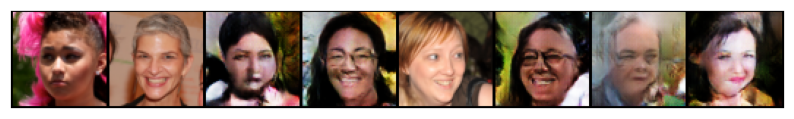

pred_label: [0 1 0 0 1 0 0 1]
real_label: [0 0 0 0 0 0 0 0]
f1_score: 0.0
accuracy_score: 0.625


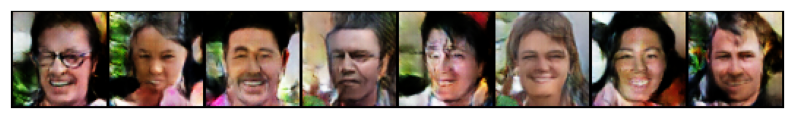

pred_label: [1 1 0 1 1 0 0 1]
real_label: [0 1 0 1 1 0 0 1]
f1_score: 0.888888888888889
accuracy_score: 0.875


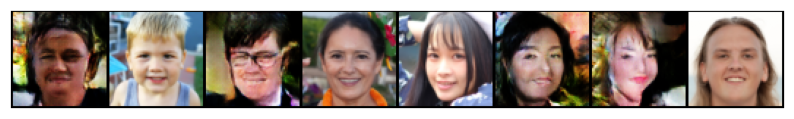

pred_label: [1 1 0 1 0 1 1 1]
real_label: [1 1 0 0 0 1 1 1]
f1_score: 0.9090909090909091
accuracy_score: 0.875


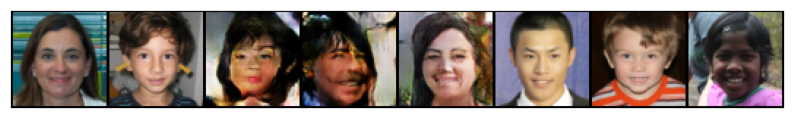

pred_label: [0 1 1 0 1 1 0 0]
real_label: [0 1 0 0 1 0 0 0]
f1_score: 0.6666666666666666
accuracy_score: 0.75


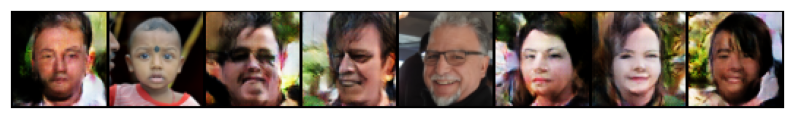

pred_label: [0 1 0 1 1 1 1 1]
real_label: [0 1 0 1 1 1 1 1]
f1_score: 1.0
accuracy_score: 1.0


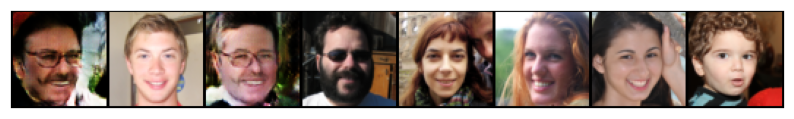

pred_label: [1 0 1 1 1 1 1 0]
real_label: [1 0 1 1 1 1 1 0]
f1_score: 1.0
accuracy_score: 1.0


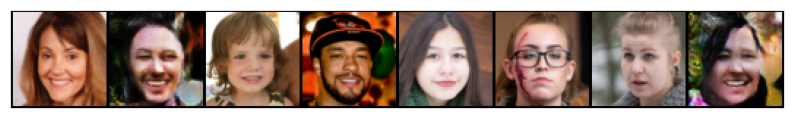

pred_label: [0 1 1 1 1 0 1 0]
real_label: [0 1 0 1 1 0 1 1]
f1_score: 0.8000000000000002
accuracy_score: 0.75


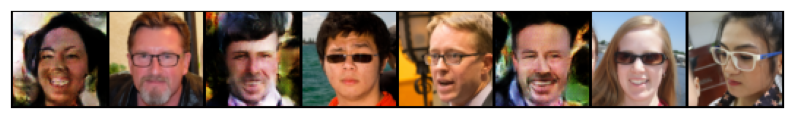

pred_label: [1 1 1 0 1 1 1 1]
real_label: [0 1 0 0 1 1 1 0]
f1_score: 0.7272727272727273
accuracy_score: 0.625


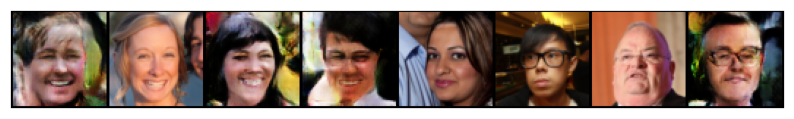

pred_label: [1 0 1 0 0 1 1 0]
real_label: [1 0 1 0 0 1 1 0]
f1_score: 1.0
accuracy_score: 1.0


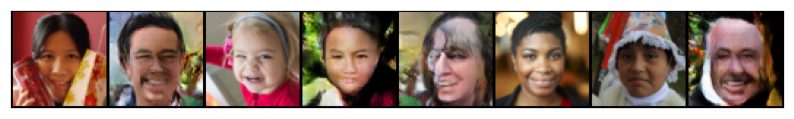

pred_label: [0 0 0 0 1 1 0 1]
real_label: [0 0 0 0 1 0 0 1]
f1_score: 0.8
accuracy_score: 0.875


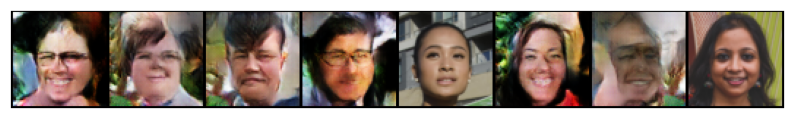

pred_label: [1 1 1 0 1 0 0 1]
real_label: [1 0 1 0 1 0 0 0]
f1_score: 0.7499999999999999
accuracy_score: 0.75


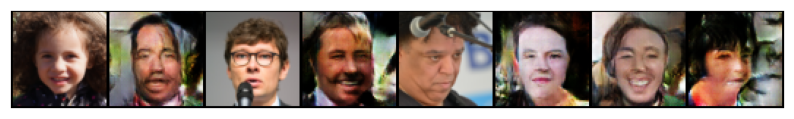

pred_label: [0 1 0 1 1 1 1 0]
real_label: [0 1 0 1 1 1 1 0]
f1_score: 1.0
accuracy_score: 1.0


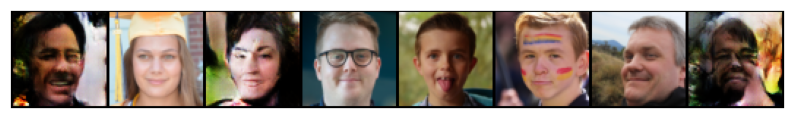

pred_label: [1 0 1 1 1 0 0 0]
real_label: [1 1 1 1 1 0 0 0]
f1_score: 0.888888888888889
accuracy_score: 0.875


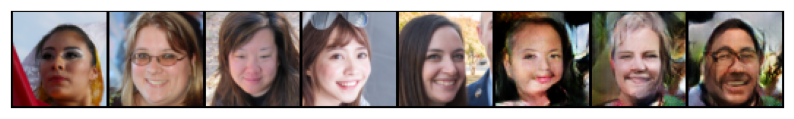

pred_label: [1 0 1 1 1 1 1 1]
real_label: [1 0 0 1 1 0 1 0]
f1_score: 0.7272727272727273
accuracy_score: 0.625


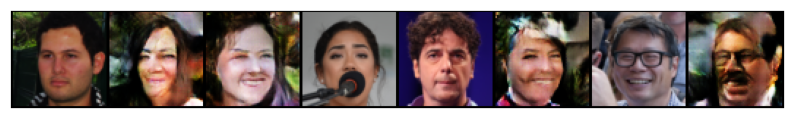

pred_label: [0 1 1 1 1 1 0 1]
real_label: [0 0 1 1 1 1 0 1]
f1_score: 0.9090909090909091
accuracy_score: 0.875


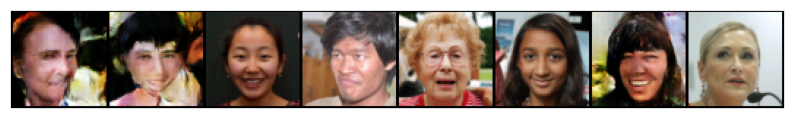

pred_label: [0 0 0 1 0 0 1 1]
real_label: [0 0 0 1 0 0 1 1]
f1_score: 1.0
accuracy_score: 1.0


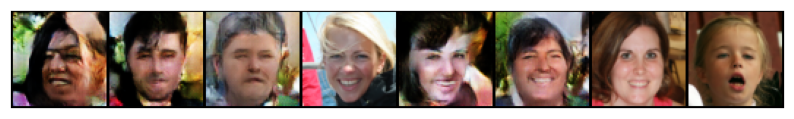

pred_label: [1 1 0 1 1 1 1 1]
real_label: [1 0 0 1 1 1 1 1]
f1_score: 0.923076923076923
accuracy_score: 0.875


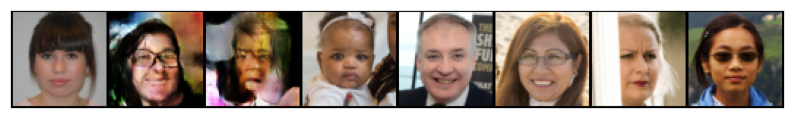

pred_label: [1 1 1 1 0 1 1 0]
real_label: [0 1 1 1 1 1 0 0]
f1_score: 0.7272727272727272
accuracy_score: 0.625


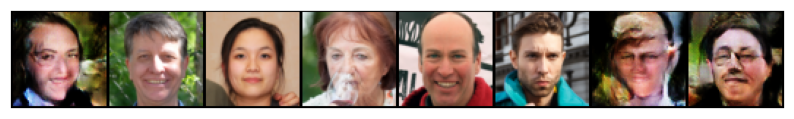

pred_label: [0 0 1 1 1 1 1 0]
real_label: [0 0 1 1 0 1 1 0]
f1_score: 0.888888888888889
accuracy_score: 0.875


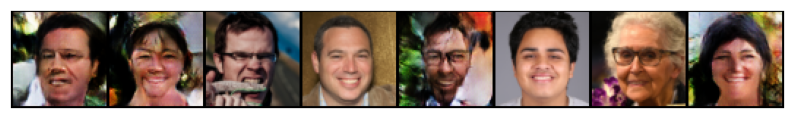

pred_label: [1 1 1 0 1 1 0 1]
real_label: [0 1 1 0 1 1 0 1]
f1_score: 0.9090909090909091
accuracy_score: 0.875


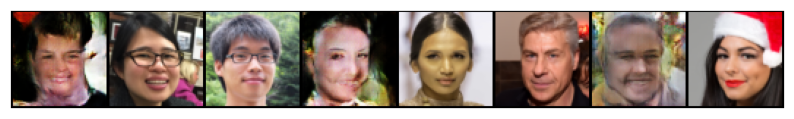

pred_label: [1 1 0 1 1 1 0 0]
real_label: [0 1 0 1 1 1 0 0]
f1_score: 0.888888888888889
accuracy_score: 0.875


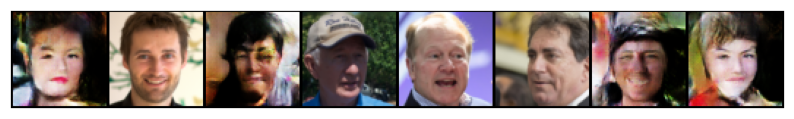

pred_label: [1 1 1 0 1 0 1 1]
real_label: [1 0 1 0 1 0 1 0]
f1_score: 0.8
accuracy_score: 0.75


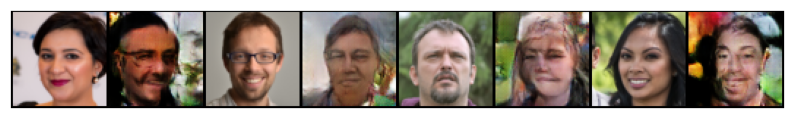

pred_label: [1 1 1 1 1 1 1 0]
real_label: [0 1 0 1 1 1 0 0]
f1_score: 0.7272727272727273
accuracy_score: 0.625


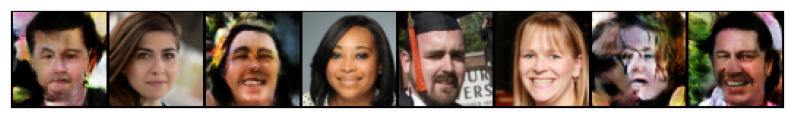

pred_label: [0 0 1 0 0 0 0 0]
real_label: [0 0 1 0 0 0 0 0]
f1_score: 1.0
accuracy_score: 1.0


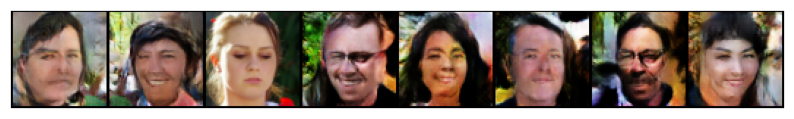

pred_label: [1 1 1 1 0 1 1 1]
real_label: [1 1 1 1 0 1 1 0]
f1_score: 0.923076923076923
accuracy_score: 0.875


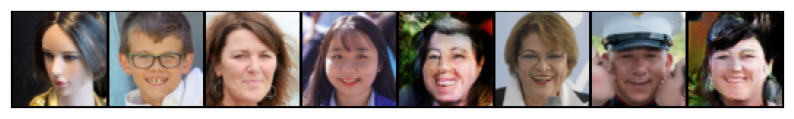

pred_label: [1 0 1 1 0 1 1 1]
real_label: [1 0 1 1 0 1 1 1]
f1_score: 1.0
accuracy_score: 1.0


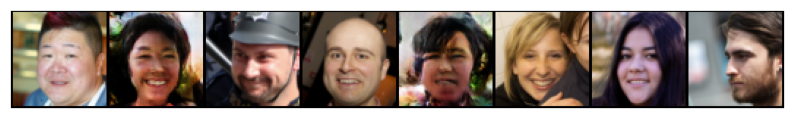

pred_label: [1 1 1 1 0 1 1 1]
real_label: [0 0 1 1 1 1 1 1]
f1_score: 0.7692307692307692
accuracy_score: 0.625


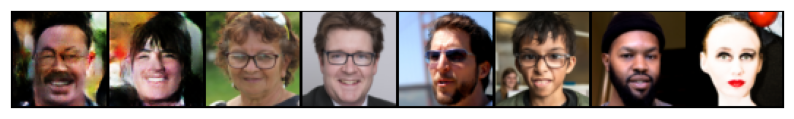

pred_label: [1 1 1 0 1 1 1 0]
real_label: [1 1 1 0 1 1 1 0]
f1_score: 1.0
accuracy_score: 1.0


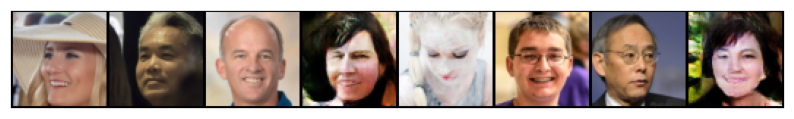

pred_label: [1 0 1 0 0 1 0 0]
real_label: [1 0 1 0 0 1 0 0]
f1_score: 1.0
accuracy_score: 1.0


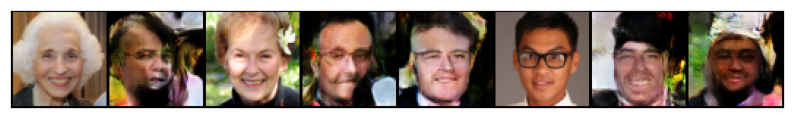

(624,)
(624,)
all f1_score: 0.8438356164383561
all accuracy_score: 0.8173076923076923


In [929]:
from sklearn.metrics import f1_score, accuracy_score

pred_labels = np.array([])
real_labels = np.array([])
for batch_images, real_label in tqdm(test_union_loader):
    real_label = 1-real_label
    flatten_batch_images = torch.flatten(batch_images, start_dim=1)
    pred_label = knn_model.predict(flatten_batch_images)
    
    pred_labels = np.append(pred_labels,pred_label)
    real_labels = np.append(real_labels,real_label.numpy())
    
    print(f"pred_label: {pred_label}")
    print(f"real_label: {real_label.numpy()}")
    print(f"f1_score: {f1_score(y_true=real_label.numpy(), y_pred=pred_label)}")
    print(f"accuracy_score: {accuracy_score(y_true=real_label.numpy(), y_pred=pred_label)}")
    show_images(batch_images)
    
print(pred_labels.shape)
print(real_labels.shape)

print(f"all f1_score: {f1_score(y_true=real_labels, y_pred=pred_labels)}")
print(f"all accuracy_score: {accuracy_score(y_true=real_labels, y_pred=pred_labels)}")

Что вы можете сказать о получившемся результате? Какой accuracy мы хотели бы получить и почему?


#### Ответ:
Модель классификации не всегда правильно определяет реальное изображение или сгенерированное.
F1_score ~ 84%, Accuracy ~ 82%
Такая точность обуславливается несколькими факторами:
- knn-модель с n_neighbors=1 сама по себе является довольно легкой моделью для классификации и понятное дело может ошибаться
- размер изображений небольшой всего 64х64 - поэтому незначительные искажения при генерации изображений не сильно влияют/выделяются
- Иногда knn-модель неверно определяет те картинки которые редкие для тренировочного датасета, например у человека на реальном фото сильно повернуту голова, такие изображения могут быть засчитаны как фейк
- При генерации попадаются довольно хорошие примеры которые визуально действительно похоже на нормальное фото, но ряд неточностей выдают фейк

### 4.2. Визуализация распределений (2 балла)

Давайте посмотрим на то, насколько похожи распределения настоящих и фейковых изображений. Для этого воспользуйтесь методом, снижающим размерность (к примеру, TSNE) и изобразите на графике разным цветом точки, соответствующие реальным и сгенерированным изображенияи

In [930]:
# В качестве распределение картинки следует использовать среднее значение станадртное отклоение
# Попробуем также использовать анализ главных компненты (PCA)

real_labels = np.array([])
x_test = None
for batch_images, real_label in tqdm(test_union_loader):
    flatten_batch_images = torch.flatten(batch_images, start_dim=1)
    if x_test is None:
        x_test = flatten_batch_images.numpy()
    else:
        x_test = np.vstack((x_test, flatten_batch_images.numpy()))
    real_labels = np.append(real_labels, real_label.numpy())
    
print(f"x_test.shape  : {x_test.shape}")
print(f"real_labels.shape  : {real_labels.shape}")


  0%|          | 0/78 [00:00<?, ?it/s]

x_test.shape  : (624, 12288)
real_labels.shape  : (624,)


#### Сравнение изображений через анализ среднего значения и станадртного отклоения

In [968]:
scatterplot_data= {}
scatterplot_data['Class'] = real_labels
scatterplot_data['Mean'] = x_test.mean(axis=1)
scatterplot_data['STD'] = x_test.std(axis=1)

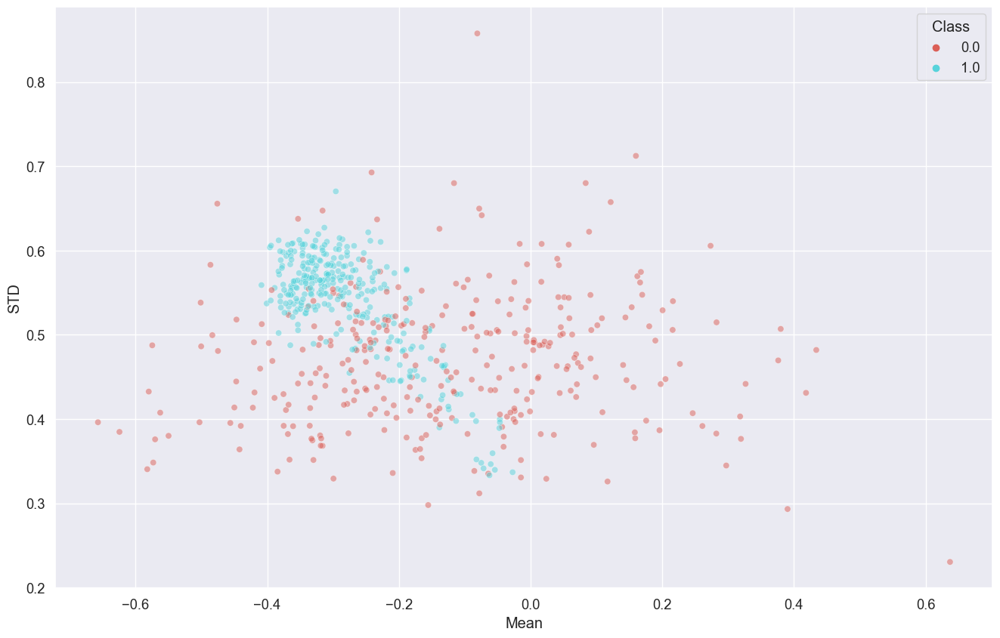

In [970]:
plt.figure(figsize=(16,10))
sns.scatterplot(
    x="Mean", y="STD",
    hue="Class",
    palette=sns.color_palette("hls", 2),
    data=scatterplot_data,
    legend="full",
    alpha=0.5
)
plt.show()

#### Сравнение изображений через анализ главных компонентов (PCA)

In [935]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
std_slc = StandardScaler()
x_std = std_slc.fit_transform(x_test)

pca = PCA(n_components=2)
x_std_pca = pca.fit_transform(x_std)
x_std.shape, x_std_pca.shape

((624, 12288), (624, 2))

In [942]:
from sklearn.manifold import TSNE
res_tsne = TSNE(n_components=2, learning_rate=150, perplexity=30, angle=0.2, verbose=2).fit_transform(x_std_pca)

D:\_Work\_Projects\_Conda\School\lib\site-packages\sklearn\manifold\_t_sne.py:783: FutureWarning: The default initialization in TSNE will change from 'random' to 'pca' in 1.2.
  FutureWarning,


[t-SNE] Computing 91 nearest neighbors...
[t-SNE] Indexed 624 samples in 0.001s...
[t-SNE] Computed neighbors for 624 samples in 0.009s...
[t-SNE] Computed conditional probabilities for sample 624 / 624
[t-SNE] Mean sigma: 9.616121
[t-SNE] Computed conditional probabilities in 0.026s
[t-SNE] Iteration 50: error = 60.4206467, gradient norm = 0.3706028 (50 iterations in 0.229s)
[t-SNE] Iteration 100: error = 55.9586525, gradient norm = 0.2928150 (50 iterations in 0.178s)
[t-SNE] Iteration 150: error = 56.1500015, gradient norm = 0.3326880 (50 iterations in 0.209s)
[t-SNE] Iteration 200: error = 56.1029434, gradient norm = 0.3384322 (50 iterations in 0.188s)
[t-SNE] Iteration 250: error = 56.2211266, gradient norm = 0.3387386 (50 iterations in 0.170s)
[t-SNE] KL divergence after 250 iterations with early exaggeration: 56.221127
[t-SNE] Iteration 300: error = 0.4516427, gradient norm = 0.0004267 (50 iterations in 0.150s)
[t-SNE] Iteration 350: error = 0.4250153, gradient norm = 0.0001298 (

In [963]:
scatterplot_data['First component'] = res_tsne[:,0]
scatterplot_data['Second component'] = res_tsne[:,1]

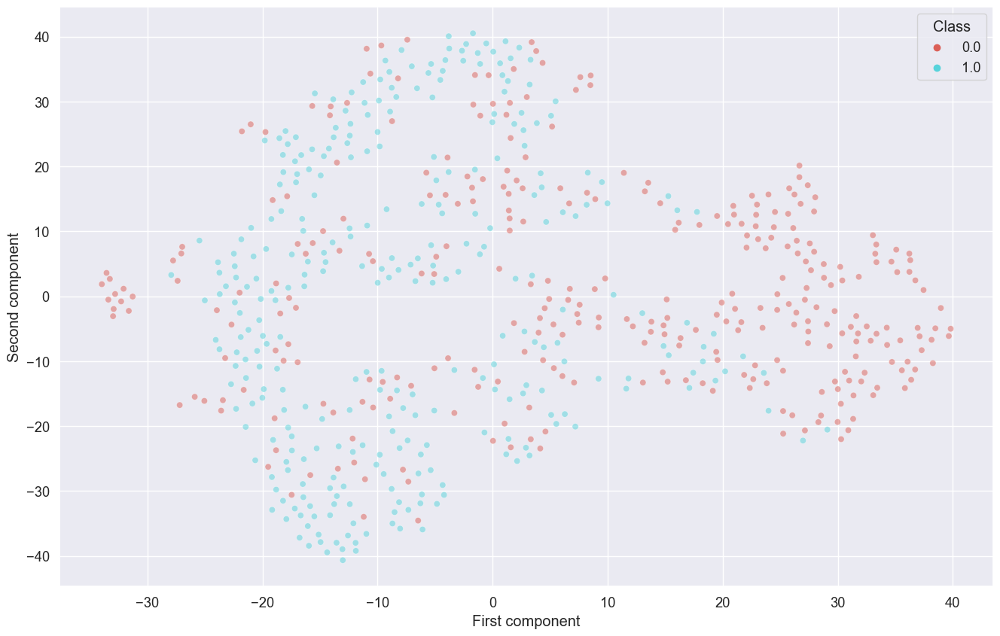

In [966]:
plt.figure(figsize=(16,10))
sns.scatterplot(
    x="First component", y="Second component",
    hue="Class",
    palette=sns.color_palette("hls", 2),
    data=scatterplot_data,
    legend="full",
    alpha=0.5
)
plt.show()

Прокомментируйте получившийся результат:

##### Вывод 
По итогам визуального анализа можно выделить:
- у реальных изображений станадртные отклонения и средние значения сгруппированы доовльно плотно в одном месте, а у фейковых встерчаются значительно больший разброс как по среднему значению так и станадртному отклонению
- Дополнительный анализ через основнные компоненты покзал что по 1 компоненте у фейковых изображений наблюдаются аномальные для реальных фото значений (меньше -30 и больше 30)

Логично что данные распределения необходмио также использовать при генерации изображений. Это можно сделать например при генерации латентоного пространства. Также можно попробовать внедрить дополнительную модель оценки сгенерированного распределения и распределения реальных фото и результат дополнительной модели можно использовать в лоссе генератора


### Общий вывод:
Дополнительно стоит выделить, что один из важнейших гиперпараметров это размер латентного пространства. Слишком маленький размер латентного пространства дает низкое качество, слишком большой размер латентного пространства также не очень хорошо использовать, т.к. при его увеличении также увеличивается время на обучения, при этом в какой-то момент прирост качества уже незначительный. Опытном путем выбраны оптимальные размеры латентного пространства: 256 или 512.


При первичном построении GAN очень легко ошибиться, и не всегда по результатам понятно в какой именно модели проблема.
Лучшим вариантом решения такого рода задач, это сначала получить минимально работающую модель и только затем накручитывать её улучшениями и утежелять. 

А так ДЗ очень классное, прям немного магии видится в этом во всем =) 

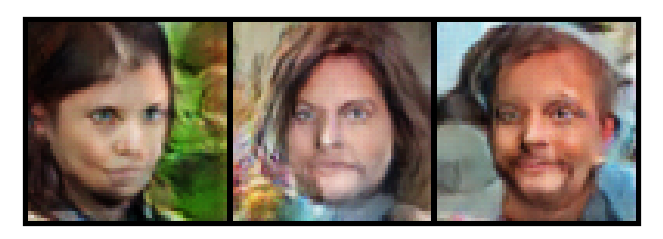